## Sofia Di Capua
## NIU: 1603685

# Introducció

T'encanta on vius i t'escandalitza perquè tothom no viu al teu país? O potser odies absolutament on vius i no entens per què algú es traslladaria al teu país. En qualsevol cas, pots obtenir resposta a les teves preguntes mitjançant aquesta anàlisi. Hi ha molts factors que afecten directament o indirectament la felicitat general d'un país. Sent una qüestió subjectiva com aquesta, conèixer exactament quins són els factors que més afecten en la felicitat d'una població és un repte.

The World Happiness Report és un dataset publicat per les Nacions Unides que classifica els països en funció dels nivells de felicitat. L'informe conté una puntuació de felicitat (Happiness Score) que després s'utilitza per a determinar el rang d'un país en relació amb les puntuacions d'un altre. Hi ha diferents mètriques que es juxtaposen amb la puntuació i tenia curiositat per veure quina mètrica podia ser assenyalada (si és que fos) com la millor predictora de la puntuació d'un país. Aquesta puntuació de felicitat s'ha calculat emprant les respostes d'una enquesta estadísticament representativa.

El World Happiness Report és un estudi històric de l'estat de la felicitat global. El primer informe es va publicar el 2012, el segon el 2013, el tercer el 2015, i el quart en l'actualització de 2016. The World Happiness 2017, que ocupa 155 països pels seus nivells de felicitat, va ser llançat a les Nacions Unides en un esdeveniment que celebra el Dia Internacional de la Felicitat el 20 de març. L'informe continua guanyant reconeixement global, ja que els governs, les organitzacions i la societat civil utilitzen cada vegada més indicadors de felicitat per informar de les seves decisions polítiques. Els principals experts en els àmbits –economia, psicologia, anàlisi de les enquestes, estadístiques nacionals, salut, polítiques públiques i més– descriuen com es poden emprar eficaçment les mesures del benestar per a avaluar el progrés de les nacions. Els informes revisen l'estat de la felicitat en el món actual i mostren com la nova ciència de la felicitat explica les variacions personals i nacionals de la felicitat.

L'enquesta a partir de la qual es va crear aquest dataset constava de preguntes amb resposta numèrica ("Imagineu una escala, amb passos numerats des del 0 com a més baix fins al 10 com a més alt. La part superior de l'escala representa la millor vida possible per a tu i el fons de l'escala representa la pitjor vida possible per a tu. En quin pas de l'escala diria vostè personalment que sent en aquest moment?") o binària ("Estàs satisfet o insatisfet amb la vostra llibertat per escollir què fas amb la teva vida?", "Has donat diners a una organització benèfica el mes passat?", etc.). Per això hi ha variables que van del 0 al 10 i d'altres que van del 0 a l'1. Per a més informació llegir els Statistical Appendix dels datasets de cada any que trobareu al següent enllaç:

https://worldhappiness.report/archive/

En aquest treball no utilitzarem només el dataset d'un any sinó els 5 datasets des de l'any 2015 fins al 2019. Es poden trobar al mateix enllaç:
https://www.kaggle.com/datasets/unsdsn/world-happiness

I per al dataset extra :
https://www.kaggle.com/datasets/mathurinache/world-happiness-report

## Imports

In [1]:
from matplotlib import pyplot as plt
from sklearn.compose import make_column_transformer
from sklearn.datasets import make_regression
from sklearn.linear_model import LinearRegression
from sklearn import preprocessing
from sklearn.preprocessing import OneHotEncoder
from sklearn.impute import KNNImputer
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import ShuffleSplit, cross_val_score
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV 
from scipy import stats

import math
import numpy as np
import pandas as pd
import random
import seaborn as sns
import scipy.stats
import statistics
import time

# Comanda per ignorar els warnings
np.warnings.filterwarnings('ignore')

# Descàrrega i adaptació del dataset

L'interès global per aquest tipus de dataset ha anat en augment des que va començar l'any 2013. A mesura que passava el temps, més estudis es volien fer i s'afegien més preguntes al qüestionari. Per aquest motiu el dataset amb menys variables era el més antic en l'enllaç de Kaggle. Això va reduir molt el nombre de variables dels altres anys, ja que havien de ser les mateixes variables per als 5 datasets.

L'explicació de com van mesurar les dades a partir de les preguntes d'un qüestionari es troba en el Statistical Appendix de cada any que es pot trobar en el següent enllaç (també es pot trobar a la introducció):
https://worldhappiness.report/archive/

Les variables que sí que vaig conservar provenen de les respostes a aquestes preguntes :

- Happiness Score : "En una escala de l'1 al 10, essent 1 el més baix i 10 el més alt, en quin pas de l'escala diria vostè personalment que sent que està ara mateix?"

- Family : "Si estaves en problemes, tens parents o amics que pots comptar per ajudar-te sempre que tinguis problemes quan els necessites o no?"

- Freedom : "Esteu satisfet o insatisfet amb la vostra llibertat per escollir amb què feu la vostra vida?"

- Trust (Government Corruption) : "La corrupció està estesa per tot el govern o no" i "la corrupció està estesa en els negocis o no?"

- Generosity : "Has donat diners a una organització benèfica el mes passat?"

Però hi ha dues variables que no estaven al qüestionari i que s'extreien d'altres fonts :

- Economy (GDP per Capita) : Extreta del World Development Indicators (WDI) que és la principal col·lecció d'indicadors de desenvolupament del Banc Mundial.

- Health (Life Expectancy) : Les sèries temporals d'esperança de vida saludable en néixer es calculen pels autors del dataset basant-se en dades de l'Organització Mundial de la Salut (OMS), els Indicadors Mundials de Desenvolupament (WDI), i estadístiques publicades en articles de revista.

A continuació explicaré les variables que vaig eliminar del dataset de l'any 2015.

D'una banda, de l'any 2015 no eren útils les variables Country, Region i Happiness Rank perquè separaven el dataset complet per països, regions i rankings. I això no contribuïa a estudiar quins factors de la vida quotidiana afecten la felicitat de les persones.

D'altra banda, les variables Dystopia Residual i Standard Error no eran útils per la informació que aportaven. Distopia és un país imaginari que té la gent menys feliç del món. El propòsit que van tenir a l'hora d'establir la variable distopia és tenir un punt de referència contra el qual tots els països poden ser comparats favorablement (cap país té un rendiment més pobre que la distopia). Tot i això, la mètrica de Dystopia Residual en realitat és la Distopia Happiness Score (1,85) + el valor Residual o el valor no explicat per a cada país. És una variable encara més subjectiva que la variable objectiu, al no aportar informació objectiva al dataset vaig preferir eliminar-la. La variable Standard Error mesura l'error estàndard de la variable Happiness Score, com que no vaig poder trobar en el Statistical Appendix com mesuraven aquest error vaig preferir eliminar-la que mantenir una variable sense explicació.

I per últim, amb els altres anys vaig mirar que les variables es conservaren. Els rename a continuació es deuen al fet que no van mantenir el nombre de les variables al llarg dels anys. Per exemple, Family se'n va canviar a Social Suport perquè generalitzava més de qui rebre el suport.

In [2]:
dt_2015 = '2015.csv'
dt_2016 = '2016.csv'
dt_2017 = '2017.csv'
dt_2018 = '2018.csv'
dt_2019 = '2019.csv'
dt_2020 = '2020.csv'


def load_dataset(path):
    dataset = pd.read_csv(path, header=0, delimiter=',')
    return dataset

dt_2015 = load_dataset(dt_2015)
dt_2015.drop(['Country','Region','Happiness Rank','Dystopia Residual','Standard Error'],axis=1,inplace=True)


dt_2016 = load_dataset(dt_2016)
dt_2016.drop(['Country','Region','Happiness Rank','Dystopia Residual',
              'Lower Confidence Interval','Upper Confidence Interval'],axis=1,inplace=True)



dt_2017 = load_dataset(dt_2017)
dt_2017.drop(['Country','Happiness.Rank','Dystopia.Residual','Whisker.high','Whisker.low'],axis=1,inplace=True)
dt_2017 = dt_2017.rename(columns={'Happiness.Score':'Happiness Score',
                                  'Economy..GDP.per.Capita.':'Economy (GDP per Capita)',
                                  'Health..Life.Expectancy.':'Health (Life Expectancy)',
                                  'Trust..Government.Corruption.':'Trust (Government Corruption)'})


dt_2018 = load_dataset(dt_2018)
dt_2018.drop(['Country or region','Overall rank'],axis=1,inplace=True)
dt_2018 = dt_2018.rename(columns={'Score':'Happiness Score',
                                  'GDP per capita':'Economy (GDP per Capita)',
                                  'Healthy life expectancy':'Health (Life Expectancy)',
                                  'Freedom to make life choices':'Freedom',
                                  'Social support':'Family',
                                  'Perceptions of corruption':'Trust (Government Corruption)'})


dt_2019 = load_dataset(dt_2019)
dt_2019.drop(['Country or region','Overall rank'],axis=1,inplace=True)
dt_2019 = dt_2019.rename(columns={'Score':'Happiness Score',
                                  'GDP per capita':'Economy (GDP per Capita)',
                                  'Healthy life expectancy':'Health (Life Expectancy)',
                                  'Freedom to make life choices':'Freedom',
                                  'Social support':'Family',
                                  'Perceptions of corruption':'Trust (Government Corruption)'})


# Extra dataset per fer el deploy:

dt_2020 = load_dataset(dt_2020)
dt_2020.drop(['Standard error of ladder score','upperwhisker', 'lowerwhisker',
              'Country name','Regional indicator', 'Ladder score in Dystopia', 'Explained by: Social support',
              'Explained by: Healthy life expectancy','Explained by: Freedom to make life choices',
              'Explained by: Generosity', 'Explained by: Perceptions of corruption','Logged GDP per capita',
              'Dystopia + residual'],axis=1,inplace=True)
dt_2020 = dt_2020.rename(columns={'Explained by: Log GDP per capita':'Economy (GDP per Capita)',
                                  'Healthy life expectancy':'Health (Life Expectancy)',
                                  'Freedom to make life choices':'Freedom',
                                  'Social support':'Family',
                                  'Ladder score':'Happiness Score',
                                  'Perceptions of corruption':'Trust (Government Corruption)'})
aux = dt_2020['Generosity']
dt_2020.drop(['Generosity'], axis=1, inplace=True)
dt_2020['Generosity'] = aux
aux = dt_2020['Health (Life Expectancy)']
dt_2020['Health (Life Expectancy)'] = aux /100

aux2 = dt_2020['Family']
aux3 = dt_2020['Health (Life Expectancy)']
aux4 = dt_2020['Freedom']
aux5 = dt_2020['Trust (Government Corruption)']
aux1 = dt_2020['Economy (GDP per Capita)']
aux6 = dt_2020['Generosity']

dt_2020.drop(['Family'], axis=1, inplace=True)
dt_2020.drop(['Health (Life Expectancy)'], axis=1, inplace=True)
dt_2020.drop(['Freedom'], axis=1, inplace=True)
dt_2020.drop(['Trust (Government Corruption)'], axis=1, inplace=True)
dt_2020.drop(['Economy (GDP per Capita)'], axis=1, inplace=True)
dt_2020.drop(['Generosity'], axis=1, inplace=True)


dt_2020['Economy (GDP per Capita)'] = abs(aux1)
dt_2020['Family'] = abs(aux2)
dt_2020['Health (Life Expectancy)'] = abs(aux3)
dt_2020['Freedom'] = abs(aux4)
dt_2020['Trust (Government Corruption)'] = abs(aux5)
dt_2020['Generosity'] = abs(aux6)


dataset = pd.concat([dt_2015, dt_2016, dt_2017, dt_2018, dt_2019])
dataset

,Happiness Score,Economy (GDP per Capita),Family,Health (Life Expectancy),Freedom,Trust (Government Corruption),Generosity
0,7.587,1.39651,1.34951,0.94143,0.66557,0.41978,0.29678
1,7.561,1.30232,1.40223,0.94784,0.62877,0.14145,0.43630
2,7.527,1.32548,1.36058,0.87464,0.64938,0.48357,0.34139
3,7.522,1.45900,1.33095,0.88521,0.66973,0.36503,0.34699
4,7.427,1.32629,1.32261,0.90563,0.63297,0.32957,0.45811
...,...,...,...,...,...,...,...
151,3.334,0.35900,0.71100,0.61400,0.55500,0.41100,0.21700
152,3.231,0.47600,0.88500,0.49900,0.41700,0.14700,0.27600
153,3.203,0.35000,0.51700,0.36100,0.00000,0.02500,0.15800
154,3.083,0.02600,0.00000,0.10500,0.22500,0.03500,0.23500


In [3]:
dt_2020

,Happiness Score,Economy (GDP per Capita),Family,Health (Life Expectancy),Freedom,Trust (Government Corruption),Generosity
0,7.8087,1.285190,0.954330,0.719008,0.949172,0.195445,0.059482
1,7.6456,1.326949,0.955991,0.724025,0.951444,0.168489,0.066202
2,7.5599,1.390774,0.942847,0.741024,0.921337,0.303728,0.105911
3,7.5045,1.326502,0.974670,0.730000,0.948892,0.711710,0.246944
4,7.4880,1.424207,0.952487,0.732008,0.955750,0.263218,0.134533
...,...,...,...,...,...,...,...
148,3.4759,0.041072,0.319460,0.452000,0.640881,0.891807,0.082410
149,3.3123,0.343243,0.540835,0.610988,0.900589,0.183541,0.055484
150,3.2992,0.425564,0.763093,0.556173,0.711458,0.810237,0.072064
151,2.8166,0.289083,0.553707,0.510000,0.451314,0.763417,0.016519


In [4]:
print(dataset.isnull().sum())
print("\n Dataset per al deploy \n")
print(dt_2020.isnull().sum())

Happiness Score                  0
Economy (GDP per Capita)         0
Family                           0
Health (Life Expectancy)         0
Freedom                          0
Trust (Government Corruption)    1
Generosity                       0
dtype: int64

 Dataset per al deploy 

Happiness Score                  0
Economy (GDP per Capita)         0
Family                           0
Health (Life Expectancy)         0
Freedom                          0
Trust (Government Corruption)    0
Generosity                       0
dtype: int64


Abans de saber que la variable Family equivalia a la variable Social Suport en els altres anys, el meu dataset tenia 312 valors NaN. Eliminar tantes files en un dataset tan petit (782 x 7) no era viable així que vaig fer un KNN Imputer.

Després d'afegir completament la variable Family de cada any, encara quedava un valor Null a la variable Trust així que vaig decidir deixar el KNN Imputer per no haver d'eliminar una fila. A continuació, procediré a explicar en què consisteix.

# KNN IMPUTER

KNN Imputer o K-Nearest Neighbour Imputer serveix per substituir els valors NaN que tants problemes poden ocassionar en valors possibles del dataset. Aquesta imputer utilitza el mètode k-Nearest Neighbors per reemplaçar els valors que manquen en els conjunts de dades amb el valor mitjà del paràmetre 'n_neighbors' veïns més propers trobats en el conjunt d'entrenament. Per defecte, utilitza una mètrica de distància euclidiana per imputar els valors que manquen.

In [5]:
imputer = KNNImputer()
dataset = pd.DataFrame(imputer.fit_transform(dataset), columns=dataset.columns.values.tolist())
dataset

,Happiness Score,Economy (GDP per Capita),Family,Health (Life Expectancy),Freedom,Trust (Government Corruption),Generosity
0,7.587,1.39651,1.34951,0.94143,0.66557,0.41978,0.29678
1,7.561,1.30232,1.40223,0.94784,0.62877,0.14145,0.43630
2,7.527,1.32548,1.36058,0.87464,0.64938,0.48357,0.34139
3,7.522,1.45900,1.33095,0.88521,0.66973,0.36503,0.34699
4,7.427,1.32629,1.32261,0.90563,0.63297,0.32957,0.45811
...,...,...,...,...,...,...,...
777,3.334,0.35900,0.71100,0.61400,0.55500,0.41100,0.21700
778,3.231,0.47600,0.88500,0.49900,0.41700,0.14700,0.27600
779,3.203,0.35000,0.51700,0.36100,0.00000,0.02500,0.15800
780,3.083,0.02600,0.00000,0.10500,0.22500,0.03500,0.23500


In [6]:
print(dataset.isnull().sum())

Happiness Score                  0
Economy (GDP per Capita)         0
Family                           0
Health (Life Expectancy)         0
Freedom                          0
Trust (Government Corruption)    0
Generosity                       0
dtype: int64


In [7]:
data = dataset

dimensio_x = data.values[:, 1:]
dimensio_y = data.values[:, 0]

print("Dimensionalitat de la BBDD:", data.shape)
print("Dimensionalitat de les entrades X", dimensio_x.shape)
print("Dimensionalitat de l'atribut Y", dimensio_y.shape)

Dimensionalitat de la BBDD: (782, 7)
Dimensionalitat de les entrades X (782, 6)
Dimensionalitat de l'atribut Y (782,)


In [8]:
data.describe()

,Happiness Score,Economy (GDP per Capita),Family,Health (Life Expectancy),Freedom,Trust (Government Corruption),Generosity
count,782.000000,782.000000,782.000000,782.000000,782.000000,782.000000,782.000000
mean,5.379018,0.916047,1.078392,0.612416,0.411091,0.125833,0.218576
std,1.127456,0.407340,0.329548,0.248309,0.152880,0.106331,0.122321
min,2.693000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,4.509750,0.606500,0.869363,0.440183,0.309768,0.054250,0.130000
50%,5.322000,0.982205,1.124735,0.647310,0.431000,0.091033,0.201982
75%,6.189500,1.236187,1.327250,0.808000,0.531000,0.156243,0.278832
max,7.769000,2.096000,1.644000,1.141000,0.724000,0.551910,0.838075


Ja tenim el dataset dels 5 anys junts amb les variables que compartien.

Ara n'hem a veure si n'hi han valors estranys que poden afectar al nostre model.

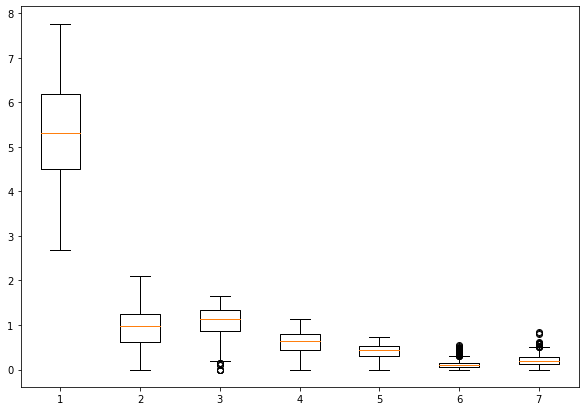

In [9]:
data_aux = data.values
 
fig = plt.figure(figsize =(10, 7))
 
# Creating plot
plt.boxplot(data_aux)
 
# show plot
plt.show()

Sembla que en els atributs Family, Trust i Generosity n'hi han outliers, n'hem a veure'ls exclusivament.

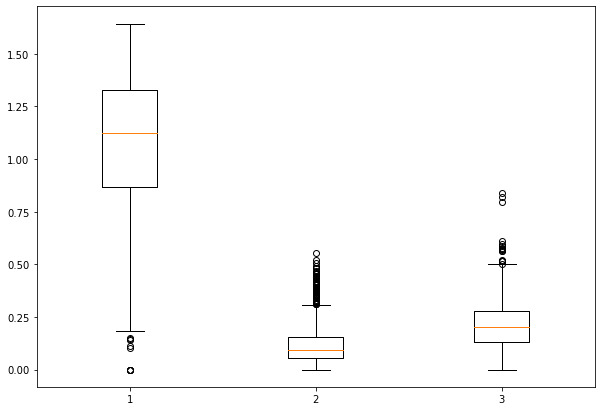

In [10]:
data_aux = [data.values[:,2], data.values[:,5], data.values[:,6]]
 
fig = plt.figure(figsize =(10, 7))
 
# Creating plot
plt.boxplot(data_aux)
 
# show plot
plt.show()

Queda confirmat que en aquests 3 atributs n'hi ha outliers. Com que aquest poden afectar molt negativament al nostre model cambiarem aquests valors per la mitjana (eliminar les seves files no es una opció ja que tenim poques moestres en el dataset). Cal mencionar que aquests valors es poden deure a les condicions nefastes o molt bones en les que es trobaben les persones que van respondre amb aquests valor extrems.

S'eliminaran els outliers de forma numèrica, un cop trobats els seus índexs seran substituïts per la mitjana aritmètica.

In [11]:
# Per tractar els outliers de Family

df_table = data["Family"]

Q1 = df_table.quantile(0.25)
Q3 = df_table.quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5*IQR
upper_bound = Q3 + 1.5*IQR
print("lower bound is " + str(lower_bound))
print("upper bound is " + str(upper_bound))
print("Q1: ", Q1)
print("Q3: ", Q3)

outliers_vector = (df_table < (lower_bound)) | (df_table > (upper_bound))
outliers_vector

outliers_vector = df_table[outliers_vector]
outliers_vector.index.values

df_table = data.copy()
df_table["Family"].iloc[outliers_vector.index.values] = df_table["Family"].mean()
df_table["Family"].iloc[outliers_vector.index.values]
print(df_table["Family"].iloc[outliers_vector.index.values])

data = df_table

lower bound is 0.18253125000000003
upper bound is 2.0140812500000003
Q1:  0.8693625
Q3:  1.32725
147    1.078392
157    1.078392
289    1.078392
310    1.078392
311    1.078392
312    1.078392
313    1.078392
469    1.078392
624    1.078392
780    1.078392
Name: Family, dtype: float64


In [12]:
# Per tractar els outliers de Trust (Government Corruption)

df_table = data["Trust (Government Corruption)"]

Q1 = df_table.quantile(0.25)
Q3 = df_table.quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5*IQR
upper_bound = Q3 + 1.5*IQR
print("lower bound is " + str(lower_bound))
print("upper bound is " + str(upper_bound))
print("Q1: ", Q1)
print("Q3: ", Q3)

outliers_vector = (df_table < (lower_bound)) | (df_table > (upper_bound))
outliers_vector

outliers_vector = df_table[outliers_vector]
outliers_vector.index.values

df_table = data.copy()
df_table["Trust (Government Corruption)"].iloc[outliers_vector.index.values] = df_table["Trust (Government Corruption)"].mean()
df_table["Trust (Government Corruption)"].iloc[outliers_vector.index.values]
print(df_table["Family"].iloc[outliers_vector.index.values])

data = df_table

lower bound is -0.0987392993825671
upper bound is 0.30923216563761186
Q1:  0.05425000000000001
Q3:  0.15624286625504474
0      1.34951
2      1.36058
3      1.33095
4      1.32261
5      1.31826
        ...   
633    1.55700
639    1.47900
641    1.55300
659    1.46300
777    0.71100
Name: Family, Length: 68, dtype: float64


In [13]:
# Per tractar els outliers de Generosity

df_table = data["Generosity"]

Q1 = df_table.quantile(0.25)
Q3 = df_table.quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5*IQR
upper_bound = Q3 + 1.5*IQR
print("lower bound is " + str(lower_bound))
print("upper bound is " + str(upper_bound))
print("Q1: ", Q1)
print("Q3: ", Q3)

outliers_vector = (df_table < (lower_bound)) | (df_table > (upper_bound))
outliers_vector

outliers_vector = df_table[outliers_vector]
outliers_vector.index.values

df_table = data.copy()
df_table["Generosity"].iloc[outliers_vector.index.values] = df_table["Generosity"].mean()
df_table["Generosity"].iloc[outliers_vector.index.values]
print(df_table["Generosity"].iloc[outliers_vector.index.values])

data = df_table

lower bound is -0.09324874999999996
upper bound is 0.5020812499999999
Q1:  0.13
Q3:  0.2788325
20     0.218576
33     0.218576
36     0.218576
73     0.218576
90     0.218576
128    0.218576
187    0.218576
190    0.218576
236    0.218576
254    0.218576
276    0.218576
341    0.218576
346    0.218576
395    0.218576
428    0.218576
599    0.218576
756    0.218576
Name: Generosity, dtype: float64


In [14]:
dt_2020

,Happiness Score,Economy (GDP per Capita),Family,Health (Life Expectancy),Freedom,Trust (Government Corruption),Generosity
0,7.8087,1.285190,0.954330,0.719008,0.949172,0.195445,0.059482
1,7.6456,1.326949,0.955991,0.724025,0.951444,0.168489,0.066202
2,7.5599,1.390774,0.942847,0.741024,0.921337,0.303728,0.105911
3,7.5045,1.326502,0.974670,0.730000,0.948892,0.711710,0.246944
4,7.4880,1.424207,0.952487,0.732008,0.955750,0.263218,0.134533
...,...,...,...,...,...,...,...
148,3.4759,0.041072,0.319460,0.452000,0.640881,0.891807,0.082410
149,3.3123,0.343243,0.540835,0.610988,0.900589,0.183541,0.055484
150,3.2992,0.425564,0.763093,0.556173,0.711458,0.810237,0.072064
151,2.8166,0.289083,0.553707,0.510000,0.451314,0.763417,0.016519


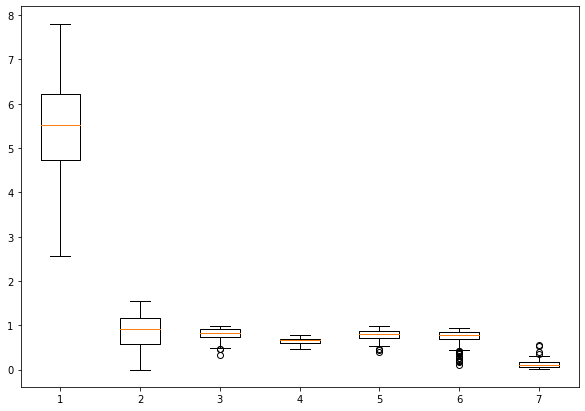

In [15]:
data_aux = dt_2020.values
 
fig = plt.figure(figsize =(10, 7))
 
# Creating plot
plt.boxplot(data_aux)
 
# show plot
plt.show()

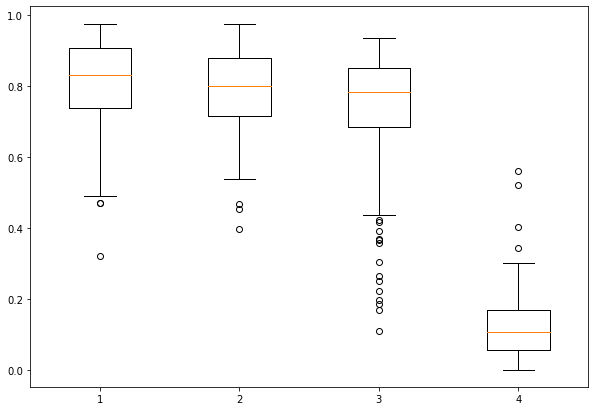

In [16]:
data_aux = [dt_2020.values[:,2], dt_2020.values[:,4], dt_2020.values[:,5], dt_2020.values[:,6]]
 
fig = plt.figure(figsize =(10, 7))
 
# Creating plot
plt.boxplot(data_aux)
 
# show plot
plt.show()

In [17]:
# Per tractar els outliers de Family

df_table = dt_2020["Family"]

Q1 = df_table.quantile(0.25)
Q3 = df_table.quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5*IQR
upper_bound = Q3 + 1.5*IQR
print("lower bound is " + str(lower_bound))
print("upper bound is " + str(upper_bound))
print("Q1: ", Q1)
print("Q3: ", Q3)

outliers_vector = (df_table < (lower_bound)) | (df_table > (upper_bound))
outliers_vector

outliers_vector = df_table[outliers_vector]
outliers_vector.index.values

df_table = dt_2020.copy()
df_table["Family"].iloc[outliers_vector.index.values] = df_table["Family"].mean()
df_table["Family"].iloc[outliers_vector.index.values]
print(df_table["Family"].iloc[outliers_vector.index.values])

dt_2020 = df_table

lower bound is 0.4829210350000001
upper bound is 1.161043315
Q1:  0.73721689
Q3:  0.90674746
85     0.808721
148    0.808721
152    0.808721
Name: Family, dtype: float64


In [18]:
# Per tractar els outliers de Freedom

df_table = dt_2020["Freedom"]

Q1 = df_table.quantile(0.25)
Q3 = df_table.quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5*IQR
upper_bound = Q3 + 1.5*IQR
print("lower bound is " + str(lower_bound))
print("upper bound is " + str(upper_bound))
print("Q1: ", Q1)
print("Q3: ", Q3)

outliers_vector = (df_table < (lower_bound)) | (df_table > (upper_bound))
outliers_vector

outliers_vector = df_table[outliers_vector]
outliers_vector.index.values

df_table = dt_2020.copy()
df_table["Freedom"].iloc[outliers_vector.index.values] = df_table["Freedom"].mean()
df_table["Freedom"].iloc[outliers_vector.index.values]
print(df_table["Freedom"].iloc[outliers_vector.index.values])

dt_2020 = df_table

lower bound is 0.4705332825
upper bound is 1.1220146705
Q1:  0.714838803
Q3:  0.87770915
99     0.78336
151    0.78336
152    0.78336
Name: Freedom, dtype: float64


In [19]:
# Per tractar els outliers de Trust (Government Corruption)

df_table = dt_2020["Trust (Government Corruption)"]

Q1 = df_table.quantile(0.25)
Q3 = df_table.quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5*IQR
upper_bound = Q3 + 1.5*IQR
print("lower bound is " + str(lower_bound))
print("upper bound is " + str(upper_bound))
print("Q1: ", Q1)
print("Q3: ", Q3)

outliers_vector = (df_table < (lower_bound)) | (df_table > (upper_bound))
outliers_vector

outliers_vector = df_table[outliers_vector]
outliers_vector.index.values

df_table = dt_2020.copy()
df_table["Trust (Government Corruption)"].iloc[outliers_vector.index.values] = df_table["Trust (Government Corruption)"].mean()
df_table["Trust (Government Corruption)"].iloc[outliers_vector.index.values]
print(df_table["Trust (Government Corruption)"].iloc[outliers_vector.index.values])

dt_2020 = df_table

lower bound is 0.43382132100000026
upper bound is 1.0983487369999998
Q1:  0.683019102
Q3:  0.8491509559999999
0      0.73312
1      0.73312
2      0.73312
4      0.73312
5      0.73312
6      0.73312
7      0.73312
9      0.73312
10     0.73312
11     0.73312
15     0.73312
30     0.73312
77     0.73312
149    0.73312
Name: Trust (Government Corruption), dtype: float64


In [20]:
# Per tractar els outliers de Generosity

df_table = dt_2020["Generosity"]

Q1 = df_table.quantile(0.25)
Q3 = df_table.quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5*IQR
upper_bound = Q3 + 1.5*IQR
print("lower bound is " + str(lower_bound))
print("upper bound is " + str(upper_bound))
print("Q1: ", Q1)
print("Q3: ", Q3)

outliers_vector = (df_table < (lower_bound)) | (df_table > (upper_bound))
outliers_vector

outliers_vector = df_table[outliers_vector]
outliers_vector.index.values

df_table = dt_2020.copy()
df_table["Generosity"].iloc[outliers_vector.index.values] = df_table["Generosity"].mean()
df_table["Generosity"].iloc[outliers_vector.index.values]
print(df_table["Generosity"].iloc[outliers_vector.index.values])

dt_2020 = df_table

lower bound is -0.11433271299999997
upper bound is 0.338511727
Q1:  0.055483952
Q3:  0.16869506199999998
83     0.12207
112    0.12207
132    0.12207
141    0.12207
Name: Generosity, dtype: float64


Ja hem tret tots el outliers ! 

## Normalització de les dades

Per explicar l'importància de la normalització utilitzaré un exemple més simple:

Considereu un conjunt de dades que contingui dues característiques, edat i ingressos. On l'edat oscil·la entre 0 i 100 anys, mentre que l'ingrés oscil·la entre 0 i 100.000 anys i més. Els ingressos són unes 1.000 vegades més grans que l'edat. Aquestes dues característiques es troben en rangs molt diferents. Quan fem més anàlisis, com la regressió lineal multivariant, per exemple, els ingressos atribuïts influiran intrínsecament el resultat més a causa del seu valor més gran. Però això no significa necessàriament que sigui més important com a predictor. Així que normalitzem les dades per a portar totes les variables al mateix interval.

El nostre dataset presenta modificacions ja realitzades a les dades que es poden veure a la comanda anterior:

* Les variables Freedom, Trust (Government Corruption) i Generosity són variables binàries, ja que el valor màxim que tenen és la mitjana dels valors 0 i 1 donats a les enquestes.

* Les variables Health (Life Expectancy) i Economy (GDP per Capita) s'han divit per 100 i 1000, respectivament, per evitar problemes d'escala.

* La variable Family és l'única que no segueix cap opció de les dues esmentades anteriorment.

Però encara no es troben en el mateix rang (0,1), per evitar que els models donin més importància a unes variables que a altres simplement per tenir valors més elevats n'hem a normalitzar o estandarditzar les dades. La diferència entre ambdues és l'assumpció de la normalitat de les dades. Si les dades segueixen una distribució Gaussiana les estandarditzarem, si no hi tenim clar, les normalitzarem.

### Visualització de les dades

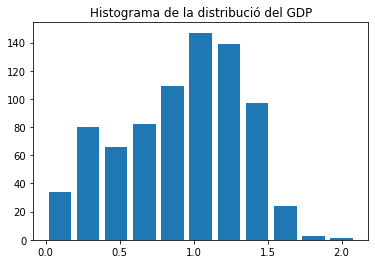

In [21]:
y = data.values[:,1]
plt.figure()
plt.title("Histograma de la distribució del GDP")
hist = plt.hist(y, bins=11, range=[np.min(y), np.max(y)], histtype="bar", rwidth=0.8)

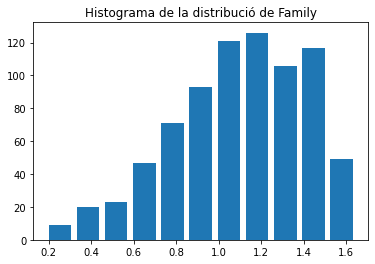

In [22]:
y = data.values[:,2]
plt.figure()
plt.title("Histograma de la distribució de Family")
hist = plt.hist(y, bins=11, range=[np.min(y), np.max(y)], histtype="bar", rwidth=0.8)

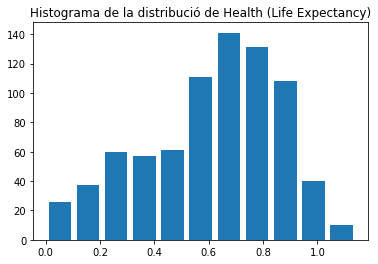

In [23]:
y = data.values[:,3]
plt.figure()
plt.title("Histograma de la distribució de Health (Life Expectancy)")
hist = plt.hist(y, bins=11, range=[np.min(y), np.max(y)], histtype="bar", rwidth=0.8)

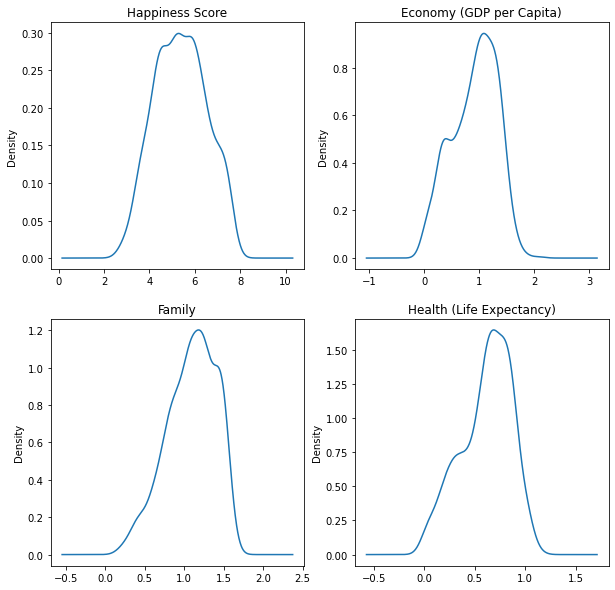

In [24]:
fig,ax = plt.subplots(2,2,figsize=(10,10))
row = col = 0
for n,c in enumerate(data.columns):
    if (n%2 == 0) & (n > 0):
        row += 1
        col = 0
    if(row == 2):
        break
    data[c].plot(kind="kde",ax=ax[row,col])
    ax[row,col].set_title(c)
    col += 1

Els plots següents són de les dades amb la distribució especificada.

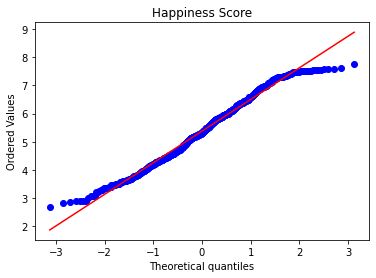

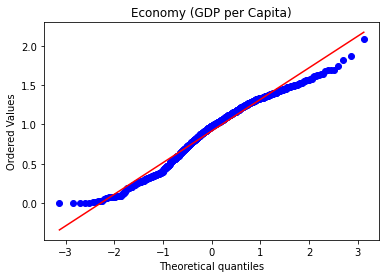

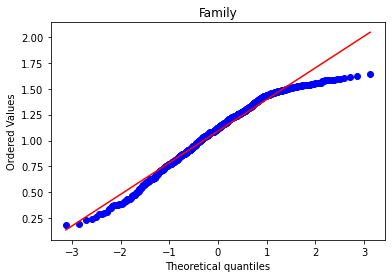

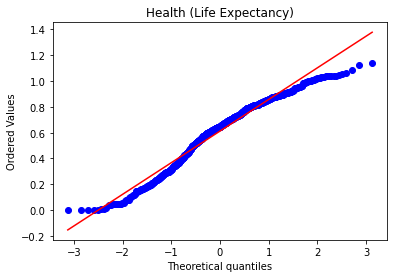

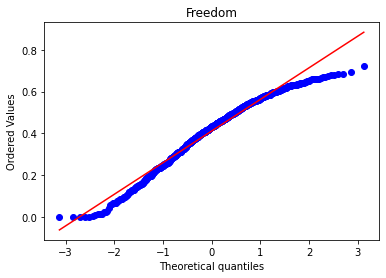

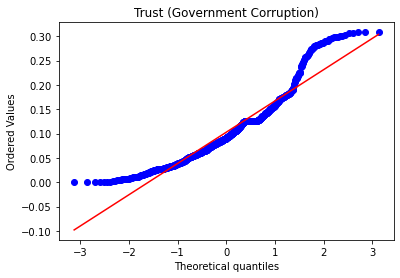

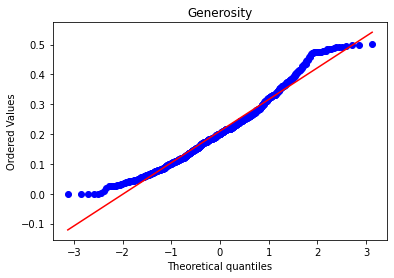

In [25]:
from scipy.stats import probplot
for i in data.columns:
    probplot(x=data[i],dist='norm',plot=plt)
    plt.title(i)
    plt.show()

### Mètodes numerics per saber la normalitat (distribució) de les dades

In [26]:
from scipy.stats import shapiro
dataset = data['Economy (GDP per Capita)']
stat, p = shapiro(dataset)
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
	print('Probably Gaussian')
else:
	print('Probably not Gaussian')

stat=0.974, p=0.000
Probably not Gaussian


In [27]:
dataset = data['Family']
stat, p = shapiro(dataset)
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
	print('Probably Gaussian')
else:
	print('Probably not Gaussian')

stat=0.969, p=0.000
Probably not Gaussian


In [28]:
dataset = data['Health (Life Expectancy)']
stat, p = shapiro(dataset)
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
	print('Probably Gaussian')
else:
	print('Probably not Gaussian')

stat=0.966, p=0.000
Probably not Gaussian


In [29]:
from scipy.stats import normaltest
for i in data.columns:
    print(f'{i}: {"Not Gaussian" if normaltest(data[i].values,)[1]<0.05 else "Gaussian"}  {normaltest(data[i].values)}')
    

Happiness Score: Not Gaussian  NormaltestResult(statistic=53.06994784809045, pvalue=2.9923145707945063e-12)
Economy (GDP per Capita): Not Gaussian  NormaltestResult(statistic=51.195858734626185, pvalue=7.637663628452032e-12)
Family: Not Gaussian  NormaltestResult(statistic=35.4567383693387, pvalue=1.9983294555146018e-08)
Health (Life Expectancy): Not Gaussian  NormaltestResult(statistic=43.27287565689175, pvalue=4.0124944348206246e-10)
Freedom: Not Gaussian  NormaltestResult(statistic=36.072489124580585, pvalue=1.4687859594818116e-08)
Trust (Government Corruption): Not Gaussian  NormaltestResult(statistic=118.23999410834105, pvalue=2.1111131416725738e-26)
Generosity: Not Gaussian  NormaltestResult(statistic=33.69391386666281, pvalue=4.824580609107667e-08)


Els mètodes emprats per visualitzar les dades ens diuen que les variables GDP, Family i Health poden ser aproximadament gaussianes, però com que numèricament no ho són, no podem estar completament segurs. Així doncs, n'hem a normalitzar les dades en comptes d'estandarditzar-les.

In [30]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
normalized_data = scaler.fit_transform(dt_2020.values[:,1:])
print(normalized_data.shape)
normalized_data = pd.DataFrame(normalized_data,columns=['Economy (GDP per Capita)','Family','Health (Life Expectancy)','Freedom','Trust (Government Corruption)','Generosity'])
#Now let’s check the mean and standard deviation values.
print(normalized_data.shape)
normalized_data.describe()

(153, 6)
(153, 6)


,Economy (GDP per Capita),Family,Health (Life Expectancy),Freedom,Trust (Government Corruption),Generosity
count,153.000000,153.000000,153.000000,153.000000,153.000000,153.000000
mean,0.565357,0.673132,0.608947,0.577125,0.676580,0.376191
std,0.242351,0.222403,0.223317,0.244849,0.197710,0.236262
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.374746,0.531377,0.435434,0.414558,0.594802,0.183773
50%,0.597751,0.699665,0.667788,0.599259,0.694871,0.351483
75%,0.760882,0.859765,0.762206,0.777459,0.827017,0.538286
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [31]:
y = pd.DataFrame(dt_2020.values[:,0], columns = ['Happiness Score'] )
y

,Happiness Score
0,7.8087
1,7.6456
2,7.5599
3,7.5045
4,7.4880
...,...
148,3.4759
149,3.3123
150,3.2992
151,2.8166


In [32]:
dt_2020 = y.join(normalized_data, lsuffix='_caller', rsuffix='_other')
print(dt_2020.shape)
dt_2020.describe()

(153, 7)


,Happiness Score,Economy (GDP per Capita),Family,Health (Life Expectancy),Freedom,Trust (Government Corruption),Generosity
count,153.00000,153.000000,153.000000,153.000000,153.000000,153.000000,153.000000
mean,5.47324,0.565357,0.673132,0.608947,0.577125,0.676580,0.376191
std,1.11227,0.242351,0.222403,0.223317,0.244849,0.197710,0.236262
min,2.56690,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,4.72410,0.374746,0.531377,0.435434,0.414558,0.594802,0.183773
50%,5.51500,0.597751,0.699665,0.667788,0.599259,0.694871,0.351483
75%,6.22850,0.760882,0.859765,0.762206,0.777459,0.827017,0.538286
max,7.80870,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [33]:
print(dt_2020.isnull().sum())

Happiness Score                  0
Economy (GDP per Capita)         0
Family                           0
Health (Life Expectancy)         0
Freedom                          0
Trust (Government Corruption)    0
Generosity                       0
dtype: int64


Ara amb el dataset que entrenarem

In [34]:
scaler = MinMaxScaler()
normalized_data = scaler.fit_transform(dimensio_x)
normalized_data = pd.DataFrame(normalized_data,columns=['Economy (GDP per Capita)','Family','Health (Life Expectancy)','Freedom','Trust (Government Corruption)','Generosity'])
#Now let’s check the mean and standard deviation values.
normalized_data.describe()

,Economy (GDP per Capita),Family,Health (Life Expectancy),Freedom,Trust (Government Corruption),Generosity
count,782.000000,782.000000,782.000000,782.000000,782.000000,782.000000
mean,0.437046,0.655956,0.536736,0.567805,0.227996,0.260807
std,0.194342,0.200455,0.217624,0.211161,0.192660,0.145954
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.289361,0.528809,0.385787,0.427856,0.098295,0.155117
50%,0.468609,0.684145,0.567318,0.595304,0.164942,0.241007
75%,0.589784,0.807330,0.708151,0.733425,0.283095,0.332706
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [35]:
y = pd.DataFrame(data.values[:,0], columns = ['Happiness Score'] )
y

,Happiness Score
0,7.587
1,7.561
2,7.527
3,7.522
4,7.427
...,...
777,3.334
778,3.231
779,3.203
780,3.083


In [36]:
data = y.join(normalized_data, lsuffix='_caller', rsuffix='_other')
print(data.shape)
data.describe()

(782, 7)


,Happiness Score,Economy (GDP per Capita),Family,Health (Life Expectancy),Freedom,Trust (Government Corruption),Generosity
count,782.000000,782.000000,782.000000,782.000000,782.000000,782.000000,782.000000
mean,5.379018,0.437046,0.655956,0.536736,0.567805,0.227996,0.260807
std,1.127456,0.194342,0.200455,0.217624,0.211161,0.192660,0.145954
min,2.693000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,4.509750,0.289361,0.528809,0.385787,0.427856,0.098295,0.155117
50%,5.322000,0.468609,0.684145,0.567318,0.595304,0.164942,0.241007
75%,6.189500,0.589784,0.807330,0.708151,0.733425,0.283095,0.332706
max,7.769000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [37]:
print(data.isnull().sum())

Happiness Score                  0
Economy (GDP per Capita)         0
Family                           0
Health (Life Expectancy)         0
Freedom                          0
Trust (Government Corruption)    0
Generosity                       0
dtype: int64


In [38]:
imputer = KNNImputer()
data = pd.DataFrame(imputer.fit_transform(data), columns=data.columns.values.tolist())
data

,Happiness Score,Economy (GDP per Capita),Family,Health (Life Expectancy),Freedom,Trust (Government Corruption),Generosity
0,7.587,0.666274,0.820870,0.825092,0.919296,0.760595,0.354121
1,7.561,0.621336,0.852938,0.830710,0.868467,0.256292,0.520598
2,7.527,0.632385,0.827603,0.766556,0.896934,0.876175,0.407350
3,7.522,0.696088,0.809580,0.775819,0.925041,0.661394,0.414032
4,7.427,0.632772,0.804507,0.793716,0.874268,0.597144,0.546622
...,...,...,...,...,...,...,...
777,3.334,0.171279,0.432482,0.538124,0.766575,0.744687,0.258927
778,3.231,0.227099,0.538321,0.437336,0.575967,0.266348,0.329326
779,3.203,0.166985,0.314477,0.316389,0.000000,0.045297,0.188527
780,3.083,0.012405,0.000000,0.092025,0.310773,0.063416,0.280404


In [39]:
print(data.isnull().sum())

Happiness Score                  0
Economy (GDP per Capita)         0
Family                           0
Health (Life Expectancy)         0
Freedom                          0
Trust (Government Corruption)    0
Generosity                       0
dtype: int64


Ja tenim el nostre dataset amb les dades normalitzades !

# Data mining

In [40]:
def correlation_matrix(data):
    plt.figure()
    sns.heatmap(data.corr(), center=0, annot=True, vmin=-1, vmax=1, cmap="RdBu_r")
    plt.savefig("correlations.png")

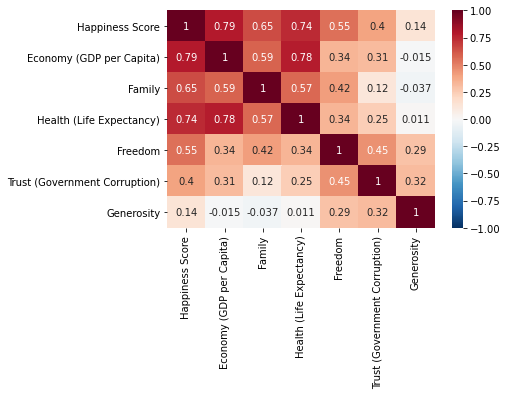

In [41]:
correlation_matrix(data)

A continuació farem un scater plot per cada parella de variables molt correlacionades en valor absolut (|cor|> 0.50): 

* GDP - Happiness Score (0.79)
* GDP - Health (0.78)
* Health - Happiness Score (0.74)
* Family - Happiness Score (0.71)
* GDP - Family (0.63)
* Freedom - Happiness Score (0.55)
* Health - Family (0.53)


<function matplotlib.pyplot.show(*args, **kw)>

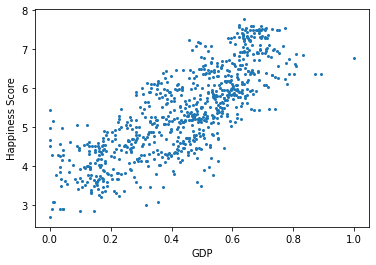

In [42]:
#Scatter amb GDP - Happiness Score 

plt.figure()
plt.scatter(data.values[:,1], data.values[:,0], s=4)
plt.xlabel("GDP")
plt.ylabel("Happiness Score")
plt.show

<function matplotlib.pyplot.show(*args, **kw)>

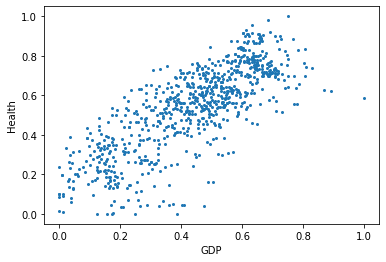

In [43]:
#Scatter amb GDP - Health

plt.figure()
plt.scatter(data.values[:,1], data.values[:,3], s=4)
plt.xlabel("GDP")
plt.ylabel("Health")
plt.show

<function matplotlib.pyplot.show(*args, **kw)>

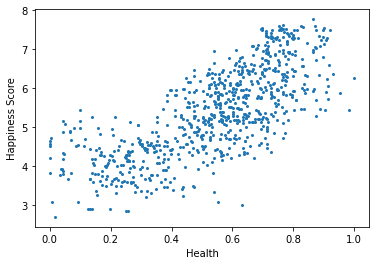

In [44]:
#Scatter amb Health - Happiness Score 

plt.figure()
plt.scatter(data.values[:,3], data.values[:,0], s=4)
plt.xlabel("Health")
plt.ylabel("Happiness Score")
plt.show

<function matplotlib.pyplot.show(*args, **kw)>

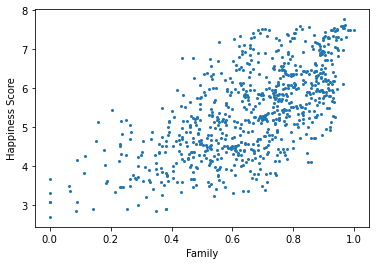

In [45]:
#Scatter amb Family - Happiness Score 

plt.figure()
plt.scatter(data.values[:,2], data.values[:,0], s=4)
plt.xlabel("Family")
plt.ylabel("Happiness Score")
plt.show

<function matplotlib.pyplot.show(*args, **kw)>

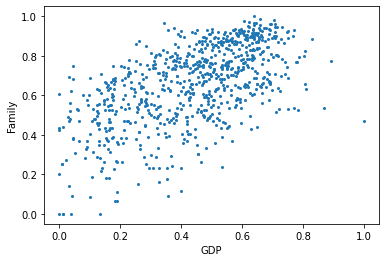

In [46]:
#Scatter amb GDP - Family 

plt.figure()
plt.scatter(data.values[:,1], data.values[:,2], s=4)
plt.xlabel("GDP")
plt.ylabel("Family")
plt.show

<function matplotlib.pyplot.show(*args, **kw)>

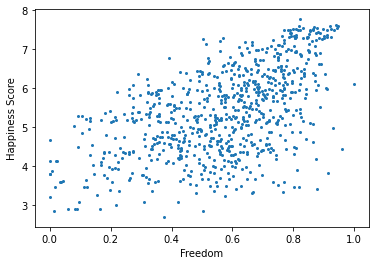

In [47]:
#Scatter amb Freedom - Happiness Score

plt.figure()
plt.scatter(data.values[:,4], data.values[:,0], s=4)
plt.xlabel("Freedom")
plt.ylabel("Happiness Score")
plt.show

<function matplotlib.pyplot.show(*args, **kw)>

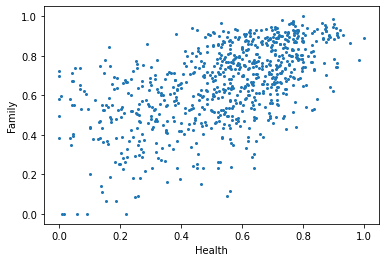

In [48]:
#Scatter amb Health - Family

plt.figure()
plt.scatter(data.values[:,3], data.values[:,2], s=4)
plt.xlabel("Health")
plt.ylabel("Family")
plt.show

Anteriorment, ja s'han mencionat les parelles de variables molt correlacionades, ara parlaré dels resultats dels plots d'aquestes parelles de variables.

En tots els plots, excepte els dos últims, es pot veure clarament una relació lineal positiva amb tendència creixent. En els dos últims plots on es relacionen la variable Freedom amb Happiness Score i Health amb Family, respectivament, no es veu tan clara una possible relació lineal, ja que les dades estan més disperses. Aquesta diferència entre els plots es deu al fet que s'han fet en ordre descendent de correlació; com menys correlacionades estiguin les variables, menys relació es podrà veure en el plot.

De tot això en podem extreure quines variables ens seran més útils per predir la variable objectiu (Hapiness Score, Y). Les variables que més correlació tenen amb aquesta són: GDP, Health, Family i Freedom. Però això no implica que les altres variables siguin innecesaries en el nostre model de predicció, ja que aquestes 4 variables poden estar molt correlacionades amb alguna de les altres no mencionades que hi ha al dataset. Mantenir dues variables molt correlacionades en el dataset, encara que una d'elles no tingui una correlació elevada amb Y, poden fer una millor predicció polinòmica que si les separem.

En conclusió, les úniques variables amb utilitat dubtosa són Trust i Generosity. Abans d'eliminar-les n'hem a fer més proves de reducció de dimensionalitat.

## PCA
Una anàlisi de components principals o ACP (PCA en àngles) cerca la projecció segons la qual les dades quedin millor representades en termes de mínims quadrats. Converteix un conjunt d'observacions de variables possiblement correlacionades en un conjunt de valors de variables sense correlació lineal anomenades components principals.

Aquesta anàlisi consisteix a fer una transformació lineal que escull un nou sistema de coordenades pel conjunt original de les dades en el qual la variància més gran de les dades es captura en el primer eix, la segona més gran en el segon eix, i així successivament. La transformació lineal descrita redueix la dimensionalitat de les dades.

In [49]:
dataset_aux2 = data.drop(['Happiness Score'], axis=1)
print(dataset_aux2)

     Economy (GDP per Capita)    Family  Health (Life Expectancy)   Freedom  \
0                    0.666274  0.820870                  0.825092  0.919296   
1                    0.621336  0.852938                  0.830710  0.868467   
2                    0.632385  0.827603                  0.766556  0.896934   
3                    0.696088  0.809580                  0.775819  0.925041   
4                    0.632772  0.804507                  0.793716  0.874268   
..                        ...       ...                       ...       ...   
777                  0.171279  0.432482                  0.538124  0.766575   
778                  0.227099  0.538321                  0.437336  0.575967   
779                  0.166985  0.314477                  0.316389  0.000000   
780                  0.012405  0.000000                  0.092025  0.310773   
781                  0.145992  0.349757                  0.258545  0.013812   

     Trust (Government Corruption)  Generosity  
0 

In [50]:
from sklearn.decomposition import PCA
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import scale
# Entrenamiento modelo PCA con escalado de los datos
# ==============================================================================
pca_pipe = make_pipeline(StandardScaler(), PCA())
pca_pipe.fit(dataset_aux2)

# Se extrae el modelo entrenado del pipeline
modelo_pca = pca_pipe.named_steps['pca']
print(modelo_pca.components_)

# Se combierte el array a dataframe para añadir nombres a los ejes.
pd.DataFrame(
    data    = modelo_pca.components_,
    columns = dataset_aux2.columns,
    index   = ['PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC6'] #Tantas componentes como columnas en X
)

[[-0.51130752 -0.45240093 -0.50204276 -0.40729955 -0.3206854  -0.11453837]
 [-0.2421235  -0.27143434 -0.25122735  0.34074474  0.49044985  0.66928051]
 [ 0.22798342 -0.47350239  0.1238236  -0.33251123  0.67051334 -0.3851427 ]
 [ 0.27362657 -0.17394869  0.35109219 -0.58605299 -0.21670239  0.61740311]
 [-0.12031767  0.67863583 -0.33775431 -0.50940966  0.37942894  0.08622395]
 [ 0.733905   -0.08153244 -0.65739022  0.06693335 -0.12690717  0.04459259]]


,Economy (GDP per Capita),Family,Health (Life Expectancy),Freedom,Trust (Government Corruption),Generosity
PC1,-0.511308,-0.452401,-0.502043,-0.407300,-0.320685,-0.114538
PC2,-0.242123,-0.271434,-0.251227,0.340745,0.490450,0.669281
PC3,0.227983,-0.473502,0.123824,-0.332511,0.670513,-0.385143
PC4,0.273627,-0.173949,0.351092,-0.586053,-0.216702,0.617403
PC5,-0.120318,0.678636,-0.337754,-0.509410,0.379429,0.086224
PC6,0.733905,-0.081532,-0.657390,0.066933,-0.126907,0.044593


La primera component principal té una gran associació negativa amb totes les variables excepte en Trust i Generosity, que són menors a la resta en valor absolut.

La segona component principal té una gran associació positiva amb les variables Trust, Generosity i Freedom, mntres uqe la resta de variables es troben en negtiu i són, en valor absolut, més petites.

La tercera component principal té una molt gran associació positiva amb la variable Trust, seguida (en valor absolut) d'una alta associació negativa amb Generosity i Family.

La quarta component principal té una gran associació negativa amb la variable Freedom i una no tan alta amb les variables Health i Generosity, totes les altres variables són menors a la resta en valor absolut.

----------------------------------------------------
Percentatge de variància explicada per cada component
----------------------------------------------------
[0.45889942 0.23267896 0.10999133 0.10386349 0.05985996 0.03470683]


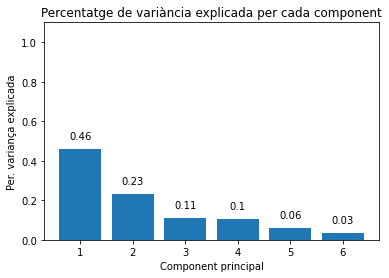

In [51]:
# Percentatge de variància explicada per cada component
# ==============================================================================
print('----------------------------------------------------')
print('Percentatge de variància explicada per cada component')
print('----------------------------------------------------')
print(modelo_pca.explained_variance_ratio_)

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(6, 4))
ax.bar(
    x      = np.arange(modelo_pca.n_components_) + 1,
    height = modelo_pca.explained_variance_ratio_
)

for x, y in zip(np.arange(len(data.columns)) + 1, modelo_pca.explained_variance_ratio_):
    label = round(y, 2)
    ax.annotate(
        label,
        (x,y),
        textcoords="offset points",
        xytext=(0,10),
        ha='center'
    )

ax.set_xticks(np.arange(modelo_pca.n_components_) + 1)
ax.set_ylim(0, 1.1)
ax.set_title('Percentatge de variància explicada per cada component')
ax.set_xlabel('Component principal')
ax.set_ylabel('Per. variança explicada');

Aquesta gràfica es pot entendre de la manera següent:

La component que correspon a PC1 compensa al voltant del 47\% la variància explicada. El que significa que una part important (100\% –47\% = 53\%) de les observacions es distribueix en més d'una dimensió.

En conclusió, el gràfic ens indica que, per mantenir un 90\% (= 47%+22%+11%+10%) de la variància explicada de les dades originals, hem d'escollir les 4 primeres components principals. I la taula ens indica que, d'aquestes 4 primeres components, les variables que tenen els coeficients en valor absolut més elevats (i, per tant, són més rellevants per calcular la component) són totes les variables del nostre dataset. Per aquesta raó no s'hauria d'eliminar cap variable, és a dir, no seria aconsellable reduir més la dimensionalitat de les nostres dades.

## TSNE

T-Distributed Stochastic Neighbor Embedding (t-SNE) és una tècnica no supervisada, no lineal, utilitzada principalment per a l'exploració de dades i la visualització de dades de moltes dimensions. En termes més senzills, t-SNE dóna una sensació o intuïció de com les dades estan disposades en un espai de moltes dimensions.

T-SNE es diferencia de la PCA per preservar només distàncies petites de parelles o similituds locals, mentre que la PCA es preocupa per preservar distàncies grans de parelles per maximitzar la variància.

Aquest algoritme ens permet separar dades que no es poden separar amb cap línia recta. Els gràfics t-SNE sovint semblen mostrar clusters, els clusters visuals poden ser fortament influenciats per la parametrització escollida i per tant és necessari una bona comprensió dels paràmetres per t-SNE. Es pot demostrar que aquests "clusters" fins i tot apareixen en dades no agrupades, i per tant poden ser troballes falses. En la nostra base de dades no tenim "clusters" que separar, el nostre problema és de regressió i, per tant, no ens serveix aquest algorisme de reducció de dimensionalitat.


## TRAIN - VAL- TEST

Això depèn principalment de dues coses. Primer, el nombre total de mostres a les vostres dades i segon, sobre el model que esteu entrenant.

Alguns models necessiten dades substancials per entrenar-se, així que en aquest cas s'optimitzaria per als Train sets més grans. Els models amb molt pocs hiperparàmetres seran fàcils de validar i sintonitzar, de manera que probablement es podrà reduir la mida del Validation set, però si el model té molts hiperparàmetres, també es voldrà tenir un Validation Set gran (tot i que també s'hauria de considerar el Cross Validation). A més, si resulta que el vostre model no té hiperparàmetres o que no es poden sintonitzar fàcilment, probablement tampoc cal un Validation Set!

En aquest treball volem probar diferents models per a un dataset petit. Per a poder tenir més llibertat a l'hora de sintonitzar una quantitat variable d'hiperparametres (depenent del model), caldria tenir un Validation set gran. Com que en tenim poques mostres, farem un Cross Validation (he fet proves per concloure que és el que millor funciona amb el meu dataset, però no les he deixades) amb un conjunt de test de mida encara per determinar.

Així doncs, n'hem a considerar alguns possibles models per a entrenar i escollir el train - test ratio (fent un CV podem presindir del Validation set) :
- Regressió lineal
- Regressió polinomial

In [52]:
y = data['Happiness Score']; y

0      7.587
1      7.561
2      7.527
3      7.522
4      7.427
       ...  
777    3.334
778    3.231
779    3.203
780    3.083
781    2.853
Name: Happiness Score, Length: 782, dtype: float64

In [53]:
dataset_aux2.head()

,Economy (GDP per Capita),Family,Health (Life Expectancy),Freedom,Trust (Government Corruption),Generosity
0,0.666274,0.820870,0.825092,0.919296,0.760595,0.354121
1,0.621336,0.852938,0.830710,0.868467,0.256292,0.520598
2,0.632385,0.827603,0.766556,0.896934,0.876175,0.407350
3,0.696088,0.809580,0.775819,0.925041,0.661394,0.414032
4,0.632772,0.804507,0.793716,0.874268,0.597144,0.546622


In [54]:
reg = LinearRegression()
for i in [0.15,0.20, 0.25, 0.30]:
    X_train, X_test, y_train, y_test = train_test_split(dataset_aux2, y, test_size=i, random_state=1012)
    model = reg.fit(X_train,y_train)
    scores = cross_val_score(model, X_train, y_train, cv=10, scoring="neg_mean_squared_error")
    print(i)
    print("intercept: ", model.intercept_)
    print("coef: ", model.coef_)
    print("rscore. ", model.score(X_train,y_train))
    print("Testing Accuracy: {:.5f}".format(model.score(X_test, y_test)))

0.15
intercept:  2.1818105246882644
coef:  [2.61717761 1.03792634 1.05826541 0.99581228 0.35788301 0.56867913]
rscore.  0.7685159665537299
Testing Accuracy: 0.73254
0.2
intercept:  2.1862484187338143
coef:  [2.64199005 1.00730461 1.07041677 0.97662311 0.32549093 0.60806927]
rscore.  0.7673578106375412
Testing Accuracy: 0.74270
0.25
intercept:  2.183848006152582
coef:  [2.58001161 0.99343043 1.13424754 0.99607237 0.31986002 0.6028854 ]
rscore.  0.7672726504950085
Testing Accuracy: 0.74983
0.3
intercept:  2.187058591121005
coef:  [2.66524529 0.96519419 1.0993735  1.0429599  0.25186109 0.57646805]
rscore.  0.7707806430726344
Testing Accuracy: 0.74128


In [55]:
reg = LinearRegression()
for i in [0.15,0.20, 0.25, 0.30]:
    X_train, X_test, y_train, y_test = train_test_split(dataset_aux2, y, test_size=i, random_state=1012)
    X_train = PolynomialFeatures(interaction_only=True).fit_transform(X_train)
    X_test = PolynomialFeatures(interaction_only=True).fit_transform(X_test)
    model = reg.fit(X_train,y_train)
    scores = cross_val_score(model, X_train, y_train, cv=10, scoring="neg_mean_squared_error")
    print(i)
    print("intercept: ", model.intercept_)
    print("coef: ", model.coef_)
    print("rscore. ", model.score(X_train,y_train))
    print("Testing Accuracy: {:.5f}".format(model.score(X_test, y_test)))

0.15
intercept:  2.9949435526742882
coef:  [ 0.          2.3055245   0.40028462 -0.37894354  0.90876515 -0.33643047
 -0.08261505 -2.41922268  1.70352217  0.5312529   0.01986238  2.70947778
  1.92131532  0.0258735   2.11817723  0.64034964  0.46044536 -1.35224251
 -1.97391131 -0.88662189 -0.70517777  1.68914104]
rscore.  0.7823787739064112
Testing Accuracy: 0.73432
0.2
intercept:  3.041705973661146
coef:  [ 0.          2.17343436  0.33451764 -0.38760807  0.92073863 -0.30913879
 -0.13344846 -2.18486219  1.86166083  0.63660931  0.02974073  2.26855339
  1.7615507  -0.11996077  2.03805967  1.01651965  0.49602243 -1.40301572
 -1.78300058 -0.80913871 -0.72244012  1.49411478]
rscore.  0.781035266617943
Testing Accuracy: 0.74918
0.25
intercept:  2.981552075628627
coef:  [ 0.          2.00499069  0.41782998 -0.0695764   0.66437483  0.09896652
 -0.07305021 -2.11736801  1.76979556  0.71421151 -0.006496    2.53708508
  1.58994473  0.09244039  2.2320289   0.28751328  0.4775655  -1.99475803
 -1.703437

Per ambdós models la millor accuracy s'assoleix amb un 25% de les mostres com a Test set. Així doncs, emprarem aquest mateix train - test ratio estudiant diferents models.

# Model Learning

En aquest apartat escollirem, entrenarem i testejarem els models per a predir la nostra variable objectiu. Està clar que el nostre problema és d'aprenentatge supervisat, ja que les dades venen amb atributs addicionals que volem predir. A patir d'aquí el nostre problema pot ser o de classificació o de regressió. Les mostres en els problemes de classificació pertanyen a dues o més classes i el que es vol predir és la classe a la qual pertanyen les mostres. És evident que el nostre dataset en presenta un problema de regressió perquè la sortida desitjada consisteix en una variable contínua.

Hi ha molts models de regressió que poden anar bé per al dataset amb el que estem treballant, però els que m'han cridat l'atenció han sigut aquests :

- Regressió lineal : és el model de regressió més simple, és molt útil per a fer proves ràpides i entendre a quines variables se li dona més pes. Un exemple de regressió lineal (en unes dades qualsevols) seria :

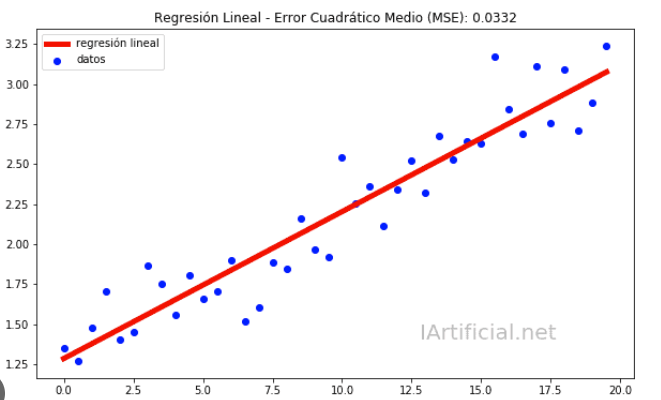

- Regressió polinomial : és un model de regressió poc més complex que l'anterior, però els motius per a escollir-lo són els mateixos. Un exemple de regressió polinomica seria :

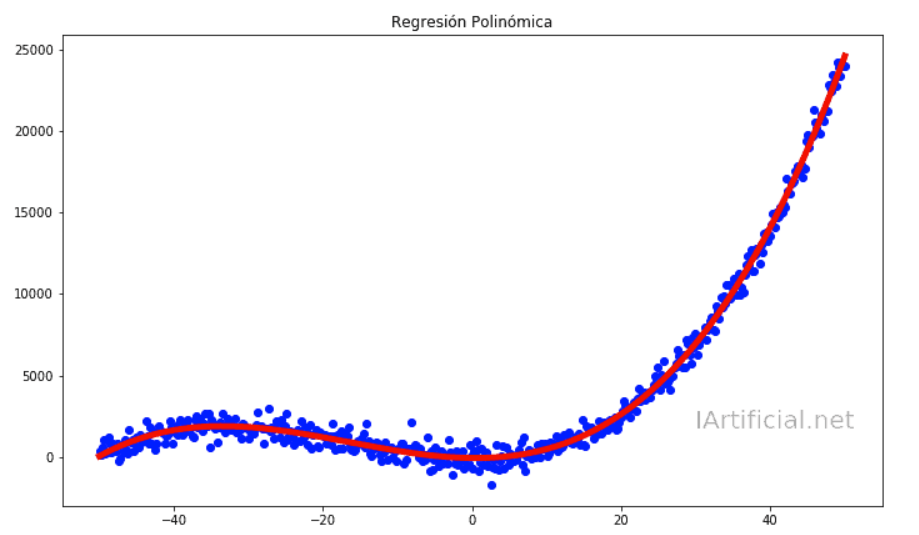

- SVM for Regression : Support Vector Regression (SVR) és una funció de regressió que és generalitzada per les Support Vector Machines - un model d'aprenentatge automàtic utilitzat per a la classificació de dades en dades contínues. L'objectiu de l'algorisme de la màquina vectorial de suport és trobar un hiperplà en un espai N-dimensional (N - el nombre de característiques) que classifiqui clarament els punts de dades. Una regressió d'aquest model tindria una forma similar a la següent:

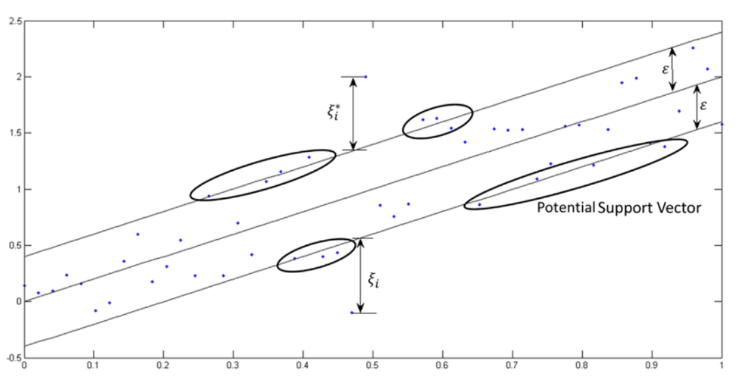

- Adaboost for Regression : aquest és un ensemble method, és a dir, combina les prediccions de diversos estimadors construïts amb un algorisme d'aprenentatge donat per tal de millorar la generalització / robustesa sobre un únic estimador. Un regressor d'AdaBoost és un meta-estimador que comença per ajustar un regressor al conjunt de dades original i després s'adapta a còpies addicionals del regressor al mateix conjunt de dades, però on els pesos de les instàncies s'ajusten segons l'error de la predicció actual.

- Random Forest for Regression : Boscos aleatoris o boscos de decisió aleatoris és un mètode d'aprenentatge conjunt per a la classificació, regressió i altres tasques que opera mitjançant la construcció d'una multitud d'arbres de decisió en el moment de l'entrenament. Per a les tasques de regressió, es retorna la predicció mitjana o mitjana dels arbres individuals. Una representació gràfica d'aquest mètode :

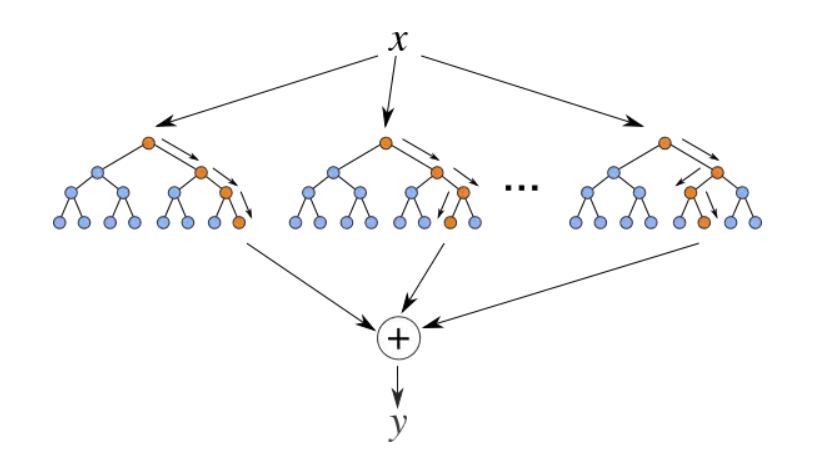

- Voting Regressor (ensemble method) : aquest també és un ensemble method com el AdaBoost, és diferència en què aquest entrena diversos regressors en tot el conjunt train i llavors fa una mitjana de les prediccions individuals per formar una predicció final.

- Neural Network for Regression : Les xarxes neuronals poden ser molt simples (desde una neurona, Perceptró) fins a una completa xarxa neuronal amb moltíssimes neurones. Una definició complexa seria que una xarxa neuronal és un model computacional que té una arquitectura de xarxa. Aquesta arquitectura està formada per neurones artificials. Aquesta estructura té paràmetres específics a través dels quals es pot modificar per dur a terme certes tasques. L'arquitectura més simple seria la de un perceptró, una única neurona, consisteix en un sol node o neurona que pren una fila de dades com a entrada i prediu una etiqueta d'una classe o un altre. A continuació us presentem una representació d'un perceptró:

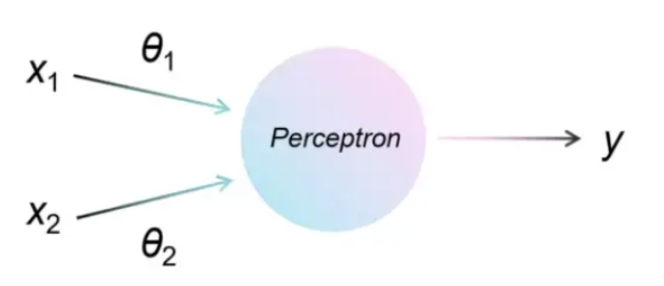

I ara una xarxa neuronal (conjunt de neurones) :

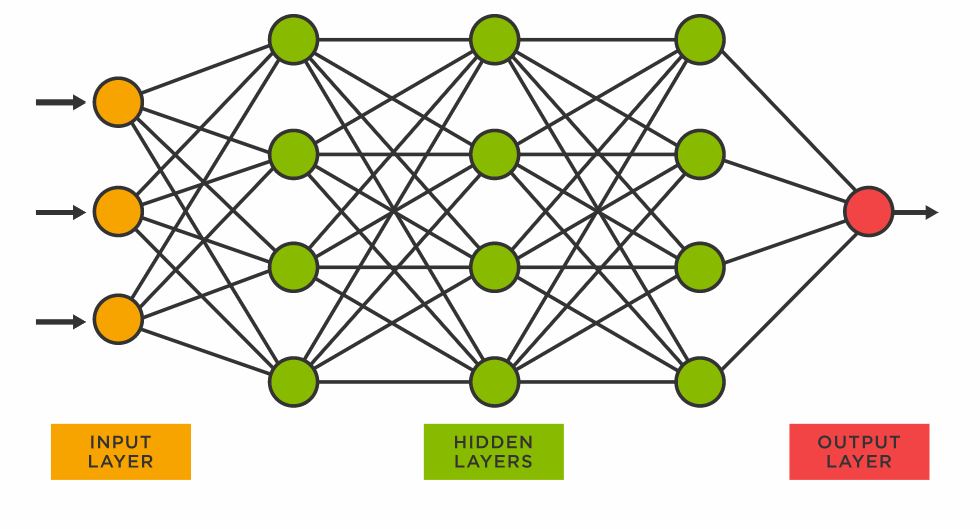

7 dels 8 models els he extret de la llibreria sklearn, podeu trobar més informació a la pàgina:
https://scikit-learn.org/stable/supervised_learning.html#supervised-learning

### Mesurar com és de bona la regressió:
Una vegada hem instanciat el model tot el que hem de fer ara és comparar els residus del Train set amb els residus del Test set (els residus són les diferències entre el valor real i el valor predit). Si el nostre procediment d'entrenament ha produït overfitting, els residus del Training set seran molt petits en comparació amb els residus del Test set. Això és un senyal negatiu que hauria de convidar-nos a simplificar el model o eliminar algunes variables.

La millor manera de donar un cop d'ull a les dades de regressió és traçant els valors predits contra els valors reals en el conjunt de test. En una condició perfecta, s'espera que els punts es trobin a la línia de 45 graus que passa per l'origen (y = x és l'equació). Com més a prop estigui el punt d'aquesta línia, millor serà la regressió. Si les nostres dades fan una taca sense forma en el pla cartesià, definitivament hi ha alguna cosa malament.

També podem mesurar com és de bona la regressió de forma numèrica, hi ha moltes mètriques, però només utilitzaré aquestes dues:
- R-Square: El valor R-Square és entre 0 i 1 i un valor més gran indica un millor ajust entre la predicció i el valor real. No obstant això, no té en compte el problema de l'overfitting.
- MSE: Dona un nombre absolut sobre quan es desvien els resultats previstos del nombre real.

### Overfitting
En l'apartat anterior (Data Mining) vam veure que la correlació de les dues últimes variables del dataset (Trust i Generosity) amb la variable objectiu era baixa. Però com el PCA no les descartava tampoc ho vaig fer. En aquest apartat vaig veure que els models no podien predir bé el dataset de l'any 2020 (el R^2 màxima era de 0,4). Així que vaig provar de treure les dues últimes variables del dataset i aquests van ser els resultats:

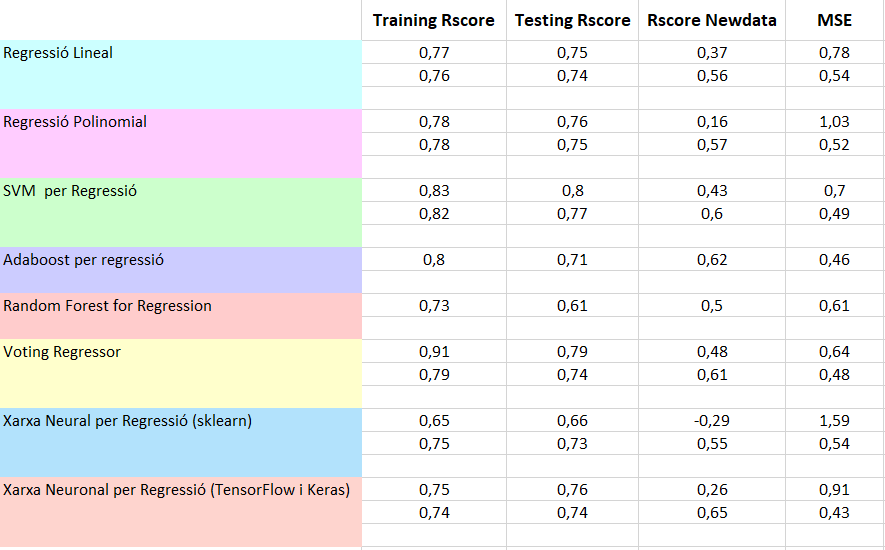

La primera fila de cada model és la realitzada amb les 6 variables del dataset i la segona és amb el dataset reduït. Es veu una clara millora de la predicció de les noves dades (R^2 màxima és de 0,65) sense gaire canvi en els conjunts de train i test. Això es deu al fet que els models feien overfitting, estaven intentant modelar unes variables que no afectaven gairebé res a la variable objectiu, és a dir, que no eren útils per predir l'Happiness Score. Que el model aprengui/memoritzi el soroll del dataset (variables irrellevants) o memoritzi les dades d'entrenament en comptes d'aprendre d'elles s'anomena overfitting.

Nota 1: Els models que només tenen una fila plena en comptes de dues és perquè es van introduir a aquesta pràctica després de canviar el dataset.

Nota 2: El canvi tan dràstic del model Voting Regressor es deu al fet que combinava un dels models eliminats que patia de massa overfitting.

## Regressió Lineal

In [56]:
dataset_aux2.drop(['Trust (Government Corruption)','Generosity'], axis=1, inplace=True)
#dataset_aux2.drop(['Trust (Government Corruption)'], axis=1, inplace=True)
dataset_aux2

,Economy (GDP per Capita),Family,Health (Life Expectancy),Freedom
0,0.666274,0.820870,0.825092,0.919296
1,0.621336,0.852938,0.830710,0.868467
2,0.632385,0.827603,0.766556,0.896934
3,0.696088,0.809580,0.775819,0.925041
4,0.632772,0.804507,0.793716,0.874268
...,...,...,...,...
777,0.171279,0.432482,0.538124,0.766575
778,0.227099,0.538321,0.437336,0.575967
779,0.166985,0.314477,0.316389,0.000000
780,0.012405,0.000000,0.092025,0.310773


In [57]:
dt_2020.drop(['Trust (Government Corruption)','Generosity'], axis=1, inplace=True)
#dt_2020.drop(['Trust (Government Corruption)'], axis=1, inplace=True)
dt_2020

,Happiness Score,Economy (GDP per Capita),Family,Health (Life Expectancy),Freedom
0,7.8087,0.836344,0.958005,0.844840,0.940925
1,7.6456,0.863519,0.961435,0.860714,0.946122
2,7.5599,0.905054,0.934297,0.914502,0.877253
3,7.5045,0.863228,1.000000,0.879619,0.940284
4,7.4880,0.926810,0.954200,0.885972,0.955972
...,...,...,...,...,...
148,3.4759,0.026728,0.657375,0.000000,0.235732
149,3.3123,0.223367,0.104285,0.503055,0.829796
150,3.2992,0.276938,0.563168,0.329612,0.397172
151,2.8166,0.188122,0.130860,0.183518,0.561643


In [58]:
reg = LinearRegression()
X_train, X_test, y_train, y_test = train_test_split(dataset_aux2, y, test_size=0.25, random_state=1012)
scores = cross_val_score(model, X_train, y_train, cv=10, scoring="neg_mean_squared_error")
model = reg.fit(X_train,y_train)
print("intercept: ", model.intercept_)
print("coef: ", model.coef_)
print("Training Rscore. ", model.score(X_train,y_train))
print("Testing Rscore: {:.5f}".format(model.score(X_test, y_test)))

intercept:  2.3083112076025243
coef:  [2.64740374 0.84189079 1.14304065 1.30400323]
Training Rscore.  0.7580477167766556
Testing Rscore: 0.73907


Fem una predicció del model per nous exemples.

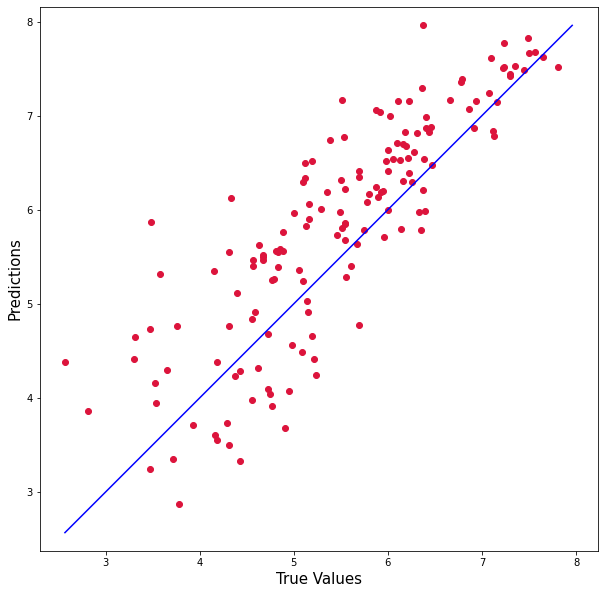

Mean Squared error :  0.5414589696301241
Rscore : 0.55945


In [59]:
Y = dt_2020.values[:,0]
X = dt_2020.values[:,1:]
y_pred = model.predict(X)

plt.figure(figsize=(10,10))
plt.scatter(Y, y_pred, c='crimson')

p1 = max(max(y_pred), max(Y))
p2 = min(min(y_pred), min(Y))
plt.plot([p1, p2], [p1, p2], 'b-')
plt.xlabel('True Values', fontsize=15)
plt.ylabel('Predictions', fontsize=15)
plt.axis('equal')
plt.show()

print("Mean Squared error : ", mean_squared_error(Y, y_pred))
print("Rscore : {:.5f}".format(model.score(X, Y))) # Provem el model amb nous exemples (deploy)

## Regressió Polinomial

Fent que l'opció interaction_only sigui falsa, en el model poden multiplicar-se dues variables (per exemple, Family * Generosity però no Family ^ 2 * Generosity ^3 si és més gran que degree).   

In [60]:
from sklearn.model_selection import cross_validate
reg = LinearRegression()
X_train, X_test, y_train, y_test = train_test_split(dataset_aux2, y, test_size=0.25, random_state=1012)

X_train = PolynomialFeatures(degree = 4, interaction_only=True).fit_transform(X_train)
X_test = PolynomialFeatures(degree = 4, interaction_only=True).fit_transform(X_test)

scores = cross_val_score(model, X_train, y_train, cv=10, scoring="neg_mean_squared_error")
model = reg.fit(X_train,y_train)
print("intercept: ", model.intercept_)
print("coef: ", model.coef_)
print("Training Rscore. ", model.score(X_train,y_train))
print("Testing Rscore :{:.5f}".format(model.score(X_test, y_test))) 

intercept:  0.24484443101865416
coef:  [  0.           9.14644893   6.625578     4.61534313   7.51397345
 -16.41750102  -8.29500918 -15.01041707  -8.29412087 -13.63615154
 -14.04138721  19.98581506  31.87541251  26.66475798  25.11483248
 -48.78597288]
Training Rscore.  0.7789609245920455
Testing Rscore :0.75105


Fem una predicció del model per nous exemples.

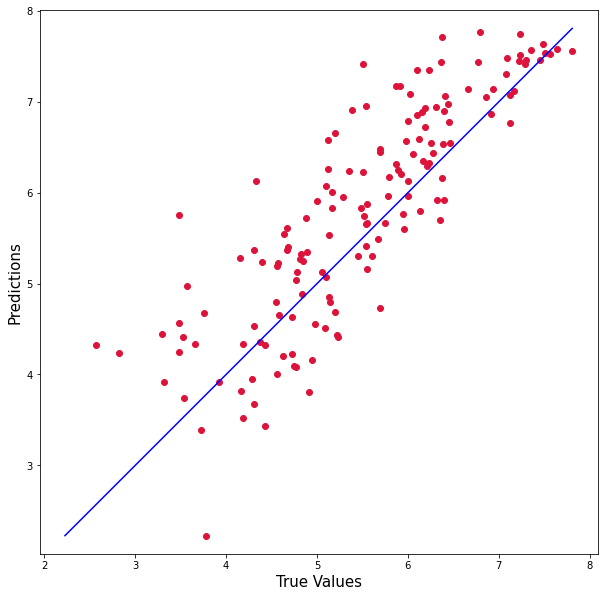

Mean Squared error :  0.5268526099457879
Rscore : 0.57134


In [61]:
Y = dt_2020.values[:,0]
X = dt_2020.values[:,1:]
X = PolynomialFeatures(degree = 4, interaction_only=True).fit_transform(X)
y_pred = model.predict(X)

plt.figure(figsize=(10,10))
plt.scatter(Y, y_pred, c='crimson')

p1 = max(max(y_pred), max(Y))
p2 = min(min(y_pred), min(Y))
plt.plot([p1, p2], [p1, p2], 'b-')
plt.xlabel('True Values', fontsize=15)
plt.ylabel('Predictions', fontsize=15)
plt.axis('equal')
plt.show()

print("Mean Squared error : ", mean_squared_error(Y, y_pred))
print("Rscore : {:.5f}".format(model.score(X, Y))) # Provem el model amb nous exemples (deploy)

## SVM for Regression

In [62]:
from sklearn import svm
reg = svm.SVR() # SVR = Suport Vector Regression
X_train, X_test, y_train, y_test = train_test_split(dataset_aux2, y, test_size=0.25, random_state=1012)
#scores = cross_val_score(model, X_train, y_train, cv=10, scoring="neg_mean_squared_error")
model = reg.fit(X_train,y_train)
print("intercept: ", model.intercept_)
#print("coef: ", model.coef_)
print("Training Rscore. ", model.score(X_train,y_train))
print("Testing Rscore :{:.5f}".format(model.score(X_test, y_test)))

intercept:  [4.94338428]
Training Rscore.  0.8181619693724218
Testing Rscore :0.77080


Fem una predicció del model per nous exemples.

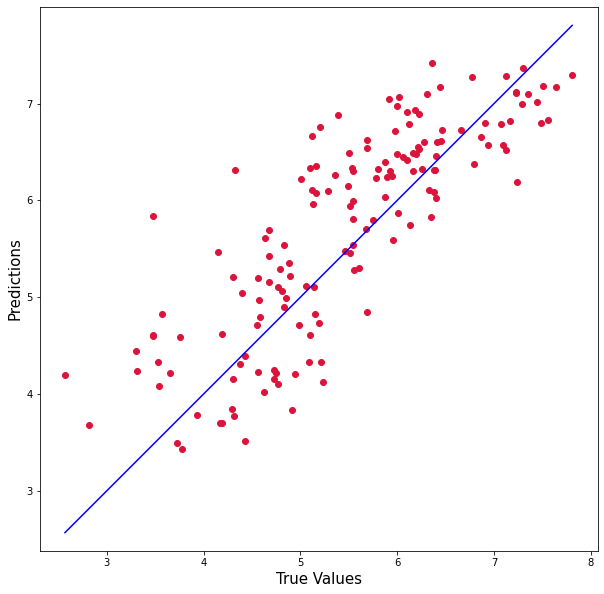

Mean Squared error :  0.48820888422641806
Rscore : 0.60278


In [63]:
Y = dt_2020.values[:,0]
X = dt_2020.values[:,1:]
y_pred = model.predict(X)

plt.figure(figsize=(10,10))
plt.scatter(Y, y_pred, c='crimson')

p1 = max(max(y_pred), max(Y))
p2 = min(min(y_pred), min(Y))
plt.plot([p1, p2], [p1, p2], 'b-')
plt.xlabel('True Values', fontsize=15)
plt.ylabel('Predictions', fontsize=15)
plt.axis('equal')
plt.show()

print("Mean Squared error : ", mean_squared_error(Y, y_pred))
print("Rscore : {:.5f}".format(model.score(X, Y))) # Provem el model amb nous exemples (deploy)

## Adaboost for Regression

In [64]:
from sklearn.ensemble import AdaBoostRegressor
#X, y = make_regression(n_features=4, n_informative=2,random_state=0, shuffle=False)
reg = AdaBoostRegressor(random_state=0, n_estimators=100)
X_train, X_test, y_train, y_test = train_test_split(dataset_aux2, y, test_size=0.25, random_state=1012)
scores = cross_val_score(model, X_train, y_train, cv=10, scoring="neg_mean_squared_error")
model = reg.fit(X_train,y_train)
#print("intercept: ", model.intercept_)
#print("coef: ", model.coef_)
print("Training Rscore. ", model.score(X_train,y_train))
print("Testing Rscore :{:.5f}".format(model.score(X_test, y_test)))

Training Rscore.  0.8048272812959354
Testing Rscore :0.71045


Fem una predicció del model per nous exemples.

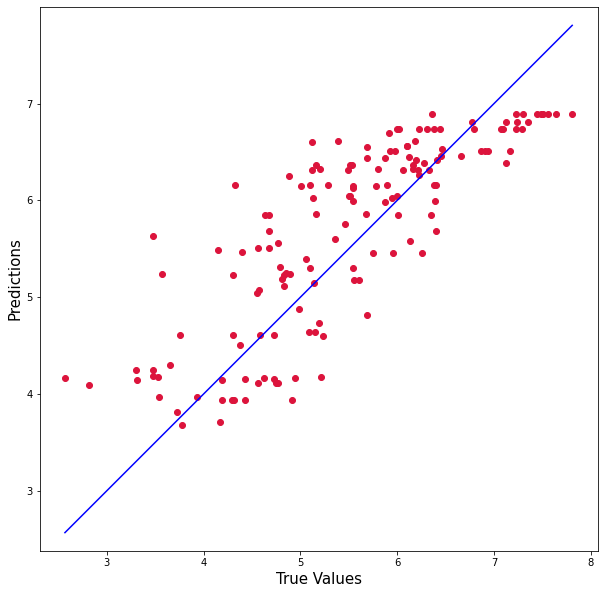

Mean Squared error :  0.46372346487787325
Rscore :0.62270


In [65]:
Y = dt_2020.values[:,0]
X = dt_2020.values[:,1:]
y_pred = model.predict(X)

plt.figure(figsize=(10,10))
plt.scatter(Y, y_pred, c='crimson')

p1 = max(max(y_pred), max(Y))
p2 = min(min(y_pred), min(Y))
plt.plot([p1, p2], [p1, p2], 'b-')
plt.xlabel('True Values', fontsize=15)
plt.ylabel('Predictions', fontsize=15)
plt.axis('equal')
plt.show()

print("Mean Squared error : ", mean_squared_error(Y, y_pred))
print("Rscore :{:.5f}".format(model.score(X, Y))) # Provem el model amb nous exemples (deploy)

## Random forest for Regression

In [66]:
from sklearn.ensemble import RandomForestRegressor
reg = RandomForestRegressor(max_depth=2, random_state=0)
X_train, X_test, y_train, y_test = train_test_split(dataset_aux2, y, test_size=0.25, random_state=1012)
scores = cross_val_score(model, X_train, y_train, cv=10, scoring="neg_mean_squared_error")
model = reg.fit(X_train,y_train)
#print("intercept: ", model.intercept_)
#print("coef: ", model.coef_)
print("Training Rscore. ", model.score(X_train,y_train))
print("Testing Rscore: {:.5f}".format(model.score(X_test, y_test)))

Training Rscore.  0.729078392213407
Testing Rscore: 0.61192


Fem una predicció del model per nous exemples.

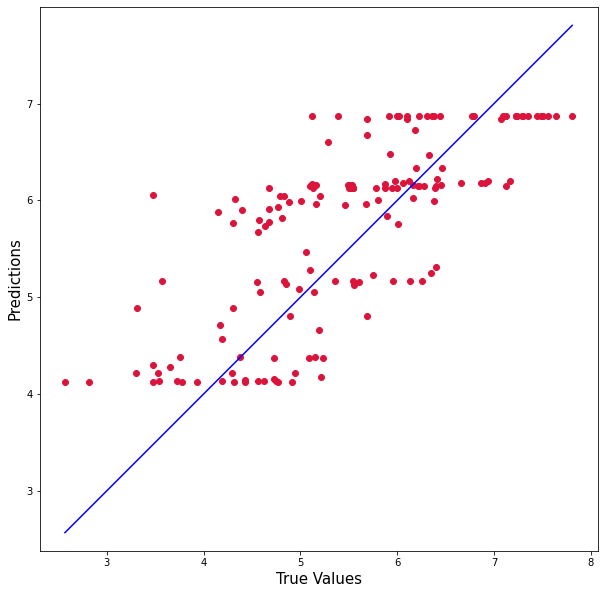

Mean Squared error :  0.6132726086144848
Rscore :0.50102


In [67]:
Y = dt_2020.values[:,0]
X = dt_2020.values[:,1:]
y_pred = model.predict(X)

plt.figure(figsize=(10,10))
plt.scatter(Y, y_pred, c='crimson')

p1 = max(max(y_pred), max(Y))
p2 = min(min(y_pred), min(Y))
plt.plot([p1, p2], [p1, p2], 'b-')
plt.xlabel('True Values', fontsize=15)
plt.ylabel('Predictions', fontsize=15)
plt.axis('equal')
plt.show()

print("Mean Squared error : ", mean_squared_error(Y, y_pred))
print("Rscore :{:.5f}".format(model.score(X, Y))) # Provem el model amb nous exemples (deploy)

## Voting Regressor (ensemble method)

L'objectiu dels mètodes de conjunt és combinar les prediccions de diversos estimadors de base construïts amb un algorisme d'aprenentatge donat per tal de millorar la generalització / robustesa sobre un únic estimador.

La idea darrere del VotingRegressor és combinar conceptualment diferents regressors d'aprenentatge automàtic i retornar la mitjana dels valors predits. Aquest tipus de regressor pot ser útil per a un conjunt de models igualment eficaços per equilibrar les seves debilitats individuals.

In [68]:
from sklearn.ensemble import VotingRegressor

reg1 = LinearRegression() # Testing Accuracy: 0.76
reg2 = svm.SVR() # Testing Accuracy: 0.82
reg3 = RandomForestRegressor(max_depth=2, random_state=0) # Testing Accuracy: 0.73

model = VotingRegressor(estimators=[('LR', reg1), ('SVR', reg2), ('DT', reg3)])

X_train, X_test, y_train, y_test = train_test_split(dataset_aux2, y, test_size=0.25, random_state=1012)
scores = cross_val_score(model, X_train, y_train, cv=10, scoring="neg_mean_squared_error")

model = model.fit(X_train, y_train)
scores = cross_val_score(model, X_train, y_train, cv=10, scoring="neg_mean_squared_error")
#print("intercept: ", model.intercept_)
#print("coef: ", model.coef_)
print("Training Rscore. ", model.score(X_train,y_train))
print("Testing Rscore :{:.5f}".format(model.score(X_test, y_test)))

Training Rscore.  0.7973123805261445
Testing Rscore :0.74268


Fem una predicció del model per nous exemples.

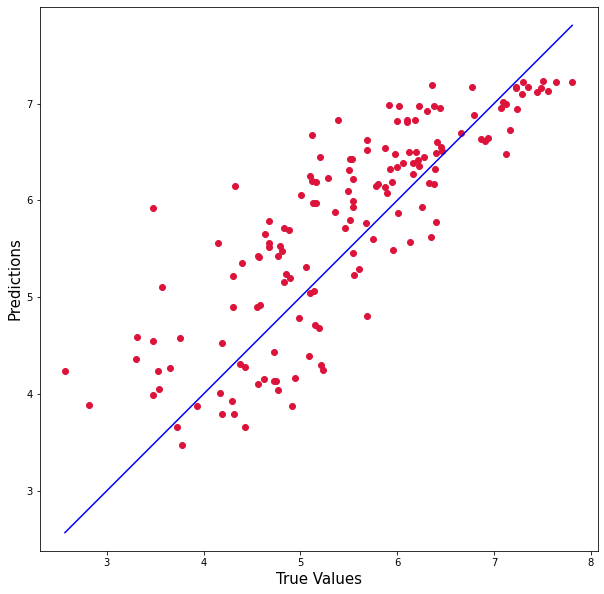

Mean Squared error :  0.4818952757498731
Rscore :0.60792


In [69]:
Y = dt_2020.values[:,0]
X = dt_2020.values[:,1:]
y_pred = model.predict(X)

plt.figure(figsize=(10,10))
plt.scatter(Y, y_pred, c='crimson')

p1 = max(max(y_pred), max(Y))
p2 = min(min(y_pred), min(Y))
plt.plot([p1, p2], [p1, p2], 'b-')
plt.xlabel('True Values', fontsize=15)
plt.ylabel('Predictions', fontsize=15)
plt.axis('equal')
plt.show()

print("Mean Squared error : ", mean_squared_error(Y, y_pred))
print("Rscore :{:.5f}".format(model.score(X, Y))) # Provem el model amb nous exemples (deploy)

## Neural Network for Regression

N'hem a fer dues xarxes neuronals iguals (més especificament un multi-layer perceptron, MLP)  però amb llibreries diferents per a comparar-les. La primera la farem amb sklearn, que és la que em estat utilitzant fins ara, i per a la segona s'emprearan TensorFlow i Keras.

In [70]:
from sklearn.neural_network import MLPRegressor
from sklearn.datasets import make_regression
from sklearn.model_selection import train_test_split


model = MLPRegressor(random_state=1, max_iter=500, activation='relu', solver='adam', 
                   hidden_layer_sizes=(2,)) # solver=optimization
X_train, X_test, y_train, y_test = train_test_split(dataset_aux2, y, test_size=0.25, random_state=1012)
scores = cross_val_score(model, X_train, y_train, cv=10)
model = model.fit(X_train,y_train)
print("Training Rscore. ", model.score(X_train,y_train))
print("Testing Rscore :{:.5f}".format(model.score(X_test, y_test)))

Training Rscore.  0.7459214626929955
Testing Rscore :0.73273


Fem una predicció del model per nous exemples.

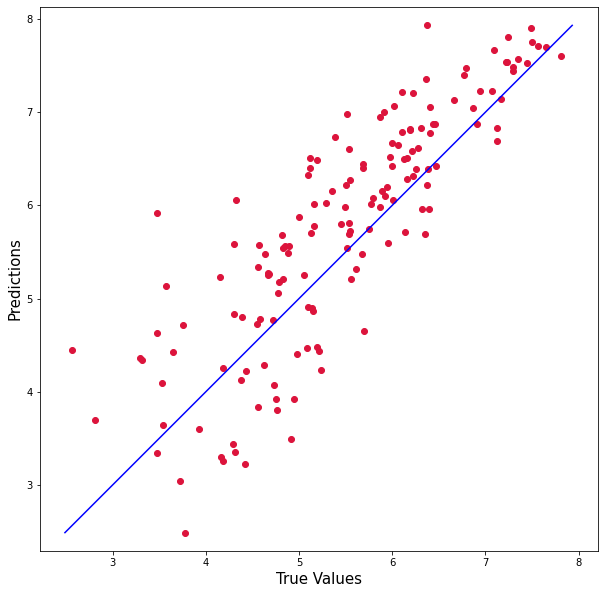

Mean Squared error :  0.5437467265127546
Rscore :0.55759


In [71]:
Y = dt_2020.values[:,0]
X = dt_2020.values[:,1:] 
y_pred = model.predict(X)

plt.figure(figsize=(10,10))
plt.scatter(Y, y_pred, c='crimson')

p1 = max(max(y_pred), max(Y))
p2 = min(min(y_pred), min(Y))
plt.plot([p1, p2], [p1, p2], 'b-')
plt.xlabel('True Values', fontsize=15)
plt.ylabel('Predictions', fontsize=15)
plt.axis('equal')
plt.show()

print("Mean Squared error : ", mean_squared_error(Y, y_pred))
print("Rscore :{:.5f}".format(model.score(X, Y))) # Provem el model amb nous exemples (deploy)

Ara farem la xarxa neuronal amb TensorFlow i Keras, codi extret de la pàgina web : 
https://thinkingneuron.com/using-artificial-neural-networks-for-regression-in-python/

Si no tens instal·lades les llibreries de TensorFlow i Keras cal descomentar les línies següents:

In [72]:
# Installing required libraries
#!pip install tensorflow
#!pip install keras

In [73]:
# importing the libraries
from keras.models import Sequential
from keras.layers import Dense
 
# create ANN model
model = Sequential()
 
# Defining the Input layer and FIRST hidden layer, both are same!
model.add(Dense(units=5, input_dim=4, kernel_initializer='normal', activation='relu'))
 
# Defining the Second layer of the model
# after the first layer we don't have to specify input_dim as keras configure it automatically
model.add(Dense(units=5, kernel_initializer='normal', activation='relu'))
model.add(Dense(units=5, kernel_initializer='normal', activation='relu'))
 
# The output neuron is a single fully connected node 
# Since we will be predicting a single number
model.add(Dense(1, kernel_initializer='normal'))
 
# Compiling the model
model.compile(loss='mean_squared_error', optimizer='adam')
 
# Fitting the ANN to the Training set
X_train, X_test, y_train, y_test = train_test_split(dataset_aux2, y, test_size=0.25, random_state=1012)
#scores = cross_val_score(model, X_train, y_train, cv=10, scoring="neg_mean_squared_error")
#print(scores.mean())
model.fit(X_train, y_train ,batch_size = 20, epochs = 50, verbose=1)
print("Training Rscore : {:.5f}".format(r2_score(y_train, model.predict(X_train))))

y_pred = model.predict(X_test)
print("Testing Rscore :{:.5f}".format(r2_score(y_test, y_pred)))

Epoch 1/50
30/30 [==============================] - 1s 1ms/step - loss: 29.9213
Epoch 2/50
30/30 [==============================] - 0s 1ms/step - loss: 29.3792
Epoch 3/50
30/30 [==============================] - 0s 1ms/step - loss: 28.4509
Epoch 4/50
30/30 [==============================] - 0s 1ms/step - loss: 26.7261
Epoch 5/50
30/30 [==============================] - 0s 1ms/step - loss: 23.6620
Epoch 6/50
30/30 [==============================] - 0s 1ms/step - loss: 18.8861
Epoch 7/50
30/30 [==============================] - 0s 1ms/step - loss: 12.5635
Epoch 8/50
30/30 [==============================] - 0s 1ms/step - loss: 6.1628
Epoch 9/50
30/30 [==============================] - 0s 1ms/step - loss: 1.9445
Epoch 10/50
30/30 [==============================] - 0s 1ms/step - loss: 0.5893
Epoch 11/50
30/30 [==============================] - 0s 1ms/step - loss: 0.4502
Epoch 12/50
30/30 [==============================] - 0s 1ms/step - loss: 0.4476
Epoch 13/50
30/30 [=======================

Fem una predicció del model per nous exemples.

5/5 [==============================] - 0s 997us/step


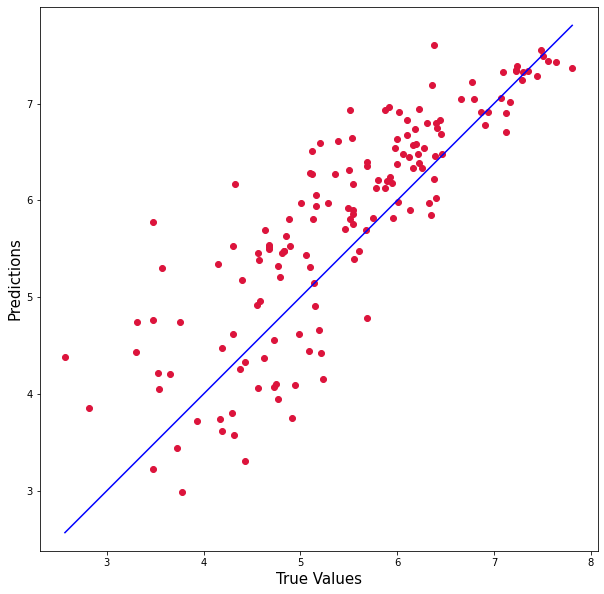

Mean Squared error :  0.4969771185700134
Testing Rscore :0.59564


In [74]:
Y = dt_2020.values[:,0]
X = dt_2020.values[:,1:] 
y_pred = model.predict(X)

plt.figure(figsize=(10,10))
plt.scatter(Y, y_pred, c='crimson')

p1 = max(max(y_pred), max(Y))
p2 = min(min(y_pred), min(Y))
plt.plot([p1, p2], [p1, p2], 'b-')
plt.xlabel('True Values', fontsize=15)
plt.ylabel('Predictions', fontsize=15)
plt.axis('equal')
plt.show()

print("Mean Squared error : ", mean_squared_error(Y, y_pred))
print("Testing Rscore :{:.5f}".format(r2_score(Y, y_pred))) # Provem el model amb nous exemples (deploy)

Fer una optimització dels hiperparàmetres amb TensorFlow és molt costós, així doncs ho he fet a mà i la combinació més optima és la empreada en la casella anterior.


# Optimització d'Hiperparàmetres

En aquest apartat empraré els dos mecanismes que vam utilitzar en la pràctica anterior: Grid Search i Random Search.

Per cadascun dels models aquests són els hiperparàmetres que he escollit per a optimitzar:
- LinearRegression() --> fit_intercept, positive (només per a dense arrays, el nostre no ho és)
- PolynomialFeatures --> No té hiperparàmetres a optimitzar, el model és un LinearRegression() amb la modificació per a ser polinomica
- SVM for Regression --> gamma, C, shrinking
- Adaboost for Regression --> n_estimators, learning_rate, loss
- Random Forest for Regression --> n_estimators, bootstrap, verbose, warm_start 
- Voting Regressor (ensemble method) --> Com que és un ensemble method no té hiperparametres propis, només els dels mètodes que està combinant.
- Neural Network for Regression --> hidden_layers_sizes, activation{‘identity’, ‘logistic’, ‘tanh’, ‘relu’}, solver{‘lbfgs’, ‘sgd’, ‘adam’}, learning_rate{‘constant’, ‘invscaling’, ‘adaptive’}, shuffle = [True, False], verbose, warm_start, early_stopping


## Regressió lineal

In [75]:
mdl = LinearRegression()
X_train, X_test, y_train, y_test = train_test_split(dataset_aux2, y, test_size=0.25, random_state=1012)
 
grid_list = {"fit_intercept": np.array([True,False])}

time_start = time.time()
grid_search = GridSearchCV(mdl, param_grid = grid_list, n_jobs = 4, cv = 10, scoring = 'r2') 

t1 = time.time() - time_start

grid_search.fit(X_train, y_train)
grid_results = grid_search.cv_results_
 

rand_list = {"fit_intercept": np.array([True,False])}       
rand_search = RandomizedSearchCV(mdl, param_distributions = rand_list, n_iter = 20, n_jobs = 4, cv = 10,
                                 random_state = 2017, scoring = 'r2') 
t2 = time.time() - t1
rand_search.fit(X_train, y_train)
rand_results = rand_search.cv_results_

In [76]:
print("---- GRID SEARCH ------")
print("Best score:", grid_search.best_score_)
print("Best param:", grid_search.best_params_)
print("Best index:", grid_search.best_index_)
print("Error score:", grid_search.error_score)
print("Time:", t1)

print("---- RANDOM SEARCH ------")
print("Best score:", rand_search.best_score_)
print("Best param:", rand_search.best_params_)
print("Best index:", rand_search.best_index_)
print("Error score:", rand_search.error_score)
print("Time:", t2)

---- GRID SEARCH ------
Best score: 0.7393037231808653
Best param: {'fit_intercept': True}
Best index: 0
Error score: nan
Time: 0.0
---- RANDOM SEARCH ------
Best score: 0.7393037231808653
Best param: {'fit_intercept': True}
Best index: 0
Error score: nan
Time: 1671140614.9187508


## SVM for Regression

In [77]:
mdl = svm.SVR()
X_train, X_test, y_train, y_test = train_test_split(dataset_aux2, y, test_size=0.25, random_state=1012)

grid_list = {"C": np.arange(2, 10, 2), "gamma": np.arange(0.1, 1, 0.2), "shrinking": [True,False]}

time_start = time.time()
grid_search = GridSearchCV(mdl, param_grid = grid_list, n_jobs = 4, cv = 10, scoring = 'r2') 
t1 = time.time() - time_start

grid_search.fit(X_train, y_train)
grid_results = grid_search.cv_results_
 

rand_list = {"C": stats.uniform(2, 10),
             "gamma": stats.uniform(0.1, 1),"shrinking": [True,False]}          
rand_search = RandomizedSearchCV(mdl, param_distributions = rand_list, n_iter = 20, n_jobs = 4, cv = 10,
                                 random_state = 2017, scoring = 'r2') 
t2 = time.time() - t1
rand_search.fit(X_train, y_train)
rand_results = rand_search.cv_results_

In [78]:
print("---- GRID SEARCH ------")
print("Best score:", grid_search.best_score_)
print("Best param:", grid_search.best_params_)
print("Best index:", grid_search.best_index_)
print("Error score:", grid_search.error_score)
print("Time:", t1)

print("---- RANDOM SEARCH ------")
print("Best score:", rand_search.best_score_)
print("Best param:", rand_search.best_params_)
print("Best index:", rand_search.best_index_)
print("Error score:", rand_search.error_score)
print("Time:", t2)

---- GRID SEARCH ------
Best score: 0.7624365366664105
Best param: {'C': 8, 'gamma': 0.9000000000000001, 'shrinking': False}
Best index: 39
Error score: nan
Time: 0.0
---- RANDOM SEARCH ------
Best score: 0.7647562963518062
Best param: {'C': 11.202086322506911, 'gamma': 1.0134265612602242, 'shrinking': True}
Best index: 16
Error score: nan
Time: 1671140617.9705877


## Adaboost per Regressió

In [79]:
mdl = AdaBoostRegressor(random_state=0)
X_train, X_test, y_train, y_test = train_test_split(dataset_aux2, y, test_size=0.25, random_state=1012)

grid_list = {"n_estimators": np.arange(25, 75, 5),
             "learning_rate": np.arange(0.0, 2, 0.2),
             "loss": ['linear', 'square', 'exponential'] }

time_start = time.time()
grid_search = GridSearchCV(mdl, param_grid = grid_list, n_jobs = 4, cv = 10, scoring = 'r2') 
t1 = time.time() - time_start

grid_search.fit(X_train, y_train)
grid_results = grid_search.cv_results_

print("---- GRID SEARCH ------")
print("Best score:", grid_search.best_score_)
print("Best param:", grid_search.best_params_)
print("Best index:", grid_search.best_index_)
print("Error score:", grid_search.error_score)
print("Time:", t1)

---- GRID SEARCH ------
Best score: 0.7470197225950818
Best param: {'learning_rate': 0.2, 'loss': 'linear', 'n_estimators': 35}
Best index: 32
Error score: nan
Time: 0.0


In [80]:
rand_list = {#"n_estimators": stats.uniform(24,50),
             "learning_rate": stats.uniform(0.0, 2),
             "loss": ['linear', 'square', 'exponential'] }

time_start = time.time()
rand_search = RandomizedSearchCV(mdl, param_distributions = rand_list, n_iter = 20, n_jobs = 4, cv = 10,
                                 random_state = 2017, scoring = 'r2') 
t2 = time.time() - time_start
rand_search.fit(X_train, y_train)
rand_results = rand_search.cv_results_

print("---- RANDOM SEARCH ------")
print("Best score:", rand_search.best_score_)
print("Best param:", rand_search.best_params_)
print("Best index:", rand_search.best_index_)
print("Error score:", rand_search.error_score)
print("Time:", t2)

---- RANDOM SEARCH ------
Best score: 0.7451421982910075
Best param: {'learning_rate': 0.19535708772531635, 'loss': 'exponential'}
Best index: 3
Error score: nan
Time: 0.0


## Random Forest

In [95]:
from sklearn.ensemble import RandomForestRegressor
model = RandomForestRegressor(random_state=0)

X_train, X_test, y_train, y_test = train_test_split(dataset_aux2, y, test_size=0.25, random_state=1012)

param_grid = { 
    "n_estimators": [100, 150],
    "bootstrap": [True, False],
    "verbose": np.arange(0,2,1),
    "warm_start": [True, False],
}

time_start = time.time()
grid_search = GridSearchCV(model, param_grid = param_grid, n_jobs = 4, cv = 10, scoring = 'r2')
t1 = time.time() - time_start

grid_search.fit(X_train, y_train)
grid_results = grid_search.cv_results_
 
param_grid = { 
    #"n_estimators": stats.uniform(100, 150),
    "bootstrap": [True, False],
    "warm_start": [True, False],
}

model = RandomForestRegressor(random_state=0)

rand_search = RandomizedSearchCV(model, param_distributions = param_grid, n_iter = 20, n_jobs = 4, cv = 10,
                                 random_state = 2017, scoring = 'r2', error_score = 'raise') 

t2 = time.time() - t1
rand_search.fit(X_train, y_train)
rand_results = rand_search.cv_results_

In [96]:
print("---- GRID SEARCH ------")
print("Best score:", grid_search.best_score_)
print("Best param:", grid_search.best_params_)
print("Best index:", grid_search.best_index_)
print("Error score:", grid_search.error_score)
print("Time:", t1)

print("---- RANDOM SEARCH ------")
print("Best score:", rand_search.best_score_)
print("Best param:", rand_search.best_params_)
print("Best index:", rand_search.best_index_)
print("Error score:", rand_search.error_score)
print("Time:", t2)

---- GRID SEARCH ------
Best score: 0.7816333195114309
Best param: {'bootstrap': True, 'n_estimators': 150, 'verbose': 0, 'warm_start': True}
Best index: 4
Error score: nan
Time: 0.0
---- RANDOM SEARCH ------
Best score: 0.7788099975389
Best param: {'warm_start': True, 'bootstrap': True}
Best index: 0
Error score: raise
Time: 1671142162.1290822


## VotingRegressor 

In [99]:
reg1 = LinearRegression(fit_intercept = True) 
reg2 = svm.SVR(C=8, gamma = 0.9, shrinking=False) 
reg3 = RandomForestRegressor(bootstrap = True, verbose = 0, warm_start = True, random_state=0) 

model = VotingRegressor(estimators=[('LR', reg1), ('SVR', reg2), ('DT', reg3)])

X_train, X_test, y_train, y_test = train_test_split(dataset_aux2, y, test_size=0.25, random_state=1012)
scores = cross_val_score(model, X_train, y_train, cv=10, scoring="neg_mean_squared_error")

model = model.fit(X_train, y_train)
scores = cross_val_score(model, X_train, y_train, cv=10, scoring="neg_mean_squared_error")
print("Training Rscore. ", model.score(X_train,y_train))
print("Testing Rscore :{:.5f}".format(model.score(X_test, y_test)))

Training Rscore.  0.8696596125846215
Testing Rscore :0.77468


In [102]:
reg1 = LinearRegression(fit_intercept = True) 
reg2 = svm.SVR(C=11, gamma = 1, shrinking=True) 
reg3 = RandomForestRegressor(bootstrap = True, warm_start = True, random_state=0) 

model = VotingRegressor(estimators=[('LR', reg1), ('SVR', reg2), ('DT', reg3)])

X_train, X_test, y_train, y_test = train_test_split(dataset_aux2, y, test_size=0.25, random_state=1012)
#scores = cross_val_score(model, X_train, y_train, cv=10, scoring="neg_mean_squared_error")

model = model.fit(X_train, y_train)
scores = cross_val_score(model, X_train, y_train, cv=10, scoring="neg_mean_squared_error")
print("Training Rscore. ", model.score(X_train,y_train))
print("Testing Rscore :{:.5f}".format(model.score(X_test, y_test)))

Training Rscore.  0.870927606095908
Testing Rscore :0.77561


## Xarxes Neuronals 

In [103]:
mdl = MLPRegressor(random_state=1, max_iter=500)

X_train, X_test, y_train, y_test = train_test_split(dataset_aux2, y, test_size=0.25, random_state=1012)

grid_list = {"activation": ['identity', 'logistic', 'tanh', 'relu'] ,
             "solver": ['lbfgs', 'sgd', 'adam'] ,
             "learning_rate": ['constant', 'invscaling', 'adaptive'] ,
             "shuffle": [True,False],
             "verbose": [True,False],
             "warm_start": [True,False],
             "early_stopping": [True,False]}

time_start = time.time()
grid_search = GridSearchCV(mdl, param_grid = grid_list, n_jobs = 4, cv = 10, scoring = 'r2') 
t1 = time.time() - time_start

grid_search.fit(X_train, y_train)
grid_results = grid_search.cv_results_
 

rand_list = {"activation": ['identity', 'logistic', 'tanh', 'relu'] ,
             "solver": ['lbfgs', 'sgd', 'adam'] ,
             "learning_rate": ['constant', 'invscaling', 'adaptive'] ,
             "shuffle": [True,False],
             "verbose": [True,False],
             "warm_start": [True,False],
             "early_stopping": [True,False]}

rand_search = RandomizedSearchCV(mdl, param_distributions = rand_list, n_iter = 20, n_jobs = 4, cv = 10,
                                 random_state = 2017, scoring = 'r2') 
t2 = time.time() - t1
rand_search.fit(X_train, y_train)
rand_results = rand_search.cv_results_

In [104]:
print("---- GRID SEARCH ------")
print("Best score:", grid_search.best_score_)
print("Best param:", grid_search.best_params_)
print("Best index:", grid_search.best_index_)
print("Error score:", grid_search.error_score)
print("Time:", t1)

print("---- RANDOM SEARCH ------")
print("Best score:", rand_search.best_score_)
print("Best param:", rand_search.best_params_)
print("Best index:", rand_search.best_index_)
print("Error score:", rand_search.error_score)
print("Time:", t2)

---- GRID SEARCH ------
Best score: 0.77395180370448
Best param: {'activation': 'relu', 'early_stopping': True, 'learning_rate': 'constant', 'shuffle': True, 'solver': 'lbfgs', 'verbose': True, 'warm_start': True}
Best index: 432
Error score: nan
Time: 0.0009970664978027344
---- RANDOM SEARCH ------
Best score: 0.77395180370448
Best param: {'warm_start': True, 'verbose': False, 'solver': 'lbfgs', 'shuffle': False, 'learning_rate': 'constant', 'early_stopping': False, 'activation': 'relu'}
Best index: 9
Error score: nan
Time: 1671143776.219346


# Comparativa de models

Abans d'optimitzar els hiperparàmetres el models que tenien una R2_score més elevada (> 0,59) en el dataset de l'any 2020 eren:
- SVM per a Regressió
- Adaboost per a Regressió
- Voting Regressor
- Xarxa neuronal per a Regressió (TensorFlow i Keras)

En aquest apartat escolliré el millor model per a ambdues bases de dades amb els hiperparàmetres òptims. Ho decidiré en funció del R2_score, MSE i del plot de les y predites amb les y reals

## SVM per a Regressió

intercept:  [4.57760047]
Training Rscore.  0.7955957219689929
Testing Rscore :0.76604


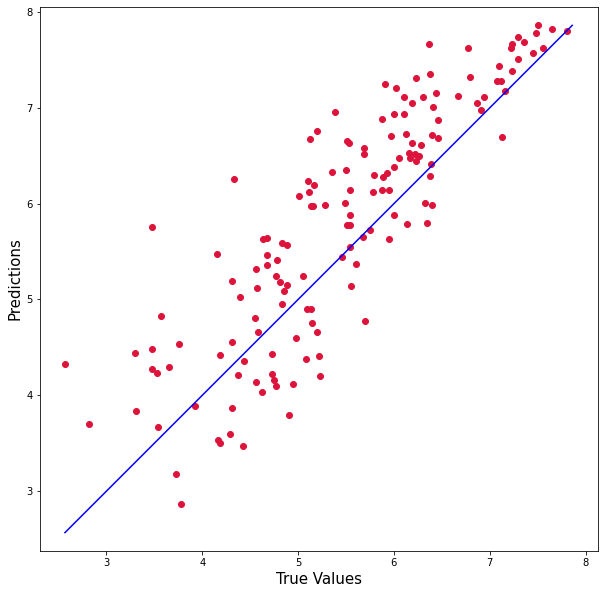

Mean Squared error :  0.5163568108430578
Rscore Newdata : 0.57988


In [105]:
reg = svm.SVR(C = 11.2, gamma = 1.01, shrinking = True)  
X_train, X_test, y_train, y_test = train_test_split(dataset_aux2, y, test_size=0.25, random_state=1012)
scores = cross_val_score(model, X_train, y_train, cv=10, scoring="neg_mean_squared_error")
model = reg.fit(X_train,y_train)
print("intercept: ", model.intercept_)
#print("coef: ", model.coef_)
print("Training Rscore. ", model.score(X_train,y_train))
print("Testing Rscore :{:.5f}".format(model.score(X_test, y_test)))

Y = dt_2020.values[:,0]
X = dt_2020.values[:,1:]
y_pred = model.predict(X)

plt.figure(figsize=(10,10))
plt.scatter(Y, y_pred, c='crimson')

p1 = max(max(y_pred), max(Y))
p2 = min(min(y_pred), min(Y))
plt.plot([p1, p2], [p1, p2], 'b-')
plt.xlabel('True Values', fontsize=15)
plt.ylabel('Predictions', fontsize=15)
plt.axis('equal')
plt.show()

print("Mean Squared error : ", mean_squared_error(Y, y_pred))
print("Rscore Newdata : {:.5f}".format(model.score(X, Y))) # Provem el model amb nous exemples (deploy)

## Adaboost per a Regressió

Training Rscore.  0.8048272812959354
Testing Rscore :0.71045


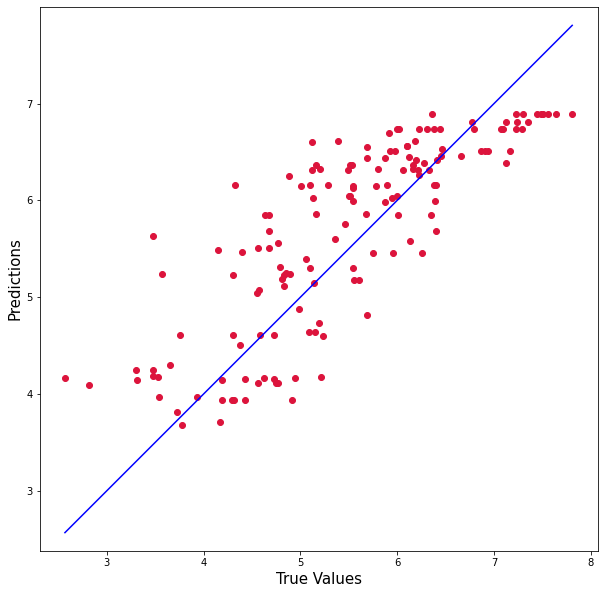

Mean Squared error :  0.46372346487787325
Rscore Newdata :0.62270


In [106]:
from sklearn.ensemble import AdaBoostRegressor
AdaBoost = AdaBoostRegressor(random_state=0, n_estimators=100)
X_train, X_test, y_train, y_test = train_test_split(dataset_aux2, y, test_size=0.25, random_state=1012)
scores = cross_val_score(AdaBoost, X_train, y_train, cv=10, scoring="neg_mean_squared_error")
#print("Mean cross-validataion score: %.2f" % scores.mean())
AdaBoost = AdaBoost.fit(X_train,y_train)
print("Training Rscore. ", AdaBoost.score(X_train,y_train))
print("Testing Rscore :{:.5f}".format(AdaBoost.score(X_test, y_test)))

Y = dt_2020.values[:,0]
X = dt_2020.values[:,1:]
y_pred = AdaBoost.predict(X)

plt.figure(figsize=(10,10))
plt.scatter(Y, y_pred, c='crimson')

p1 = max(max(y_pred), max(Y))
p2 = min(min(y_pred), min(Y))
plt.plot([p1, p2], [p1, p2], 'b-')
plt.xlabel('True Values', fontsize=15)
plt.ylabel('Predictions', fontsize=15)
plt.axis('equal')
plt.show()

print("Mean Squared error : ", mean_squared_error(Y, y_pred))
print("Rscore Newdata :{:.5f}".format(AdaBoost.score(X, Y))) # Provem el model amb nous exemples (deploy)

## Voting per a Regressió

Les dues opcions començades en l'apartat anterior són pràcticament iguals així que ara només hi haurà una:

Training Rscore.  0.8696596125846215
Testing Rscore :0.77468


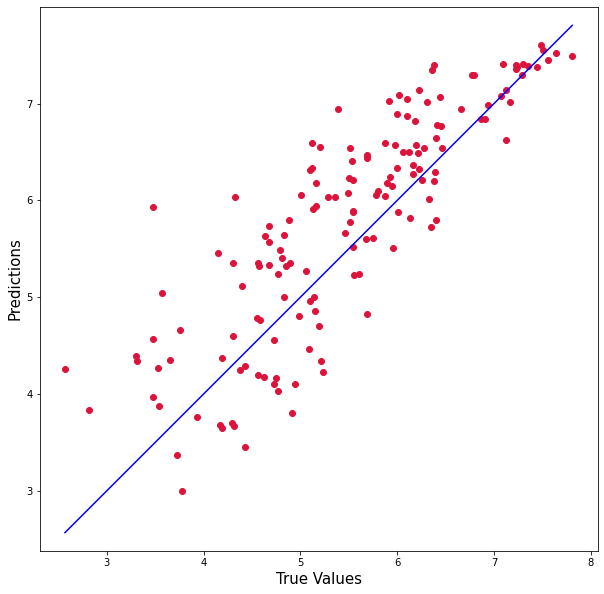

Mean Squared error :  0.48408854437168386
Rscore Newdata :0.60613


In [107]:
reg1 = LinearRegression(fit_intercept = True) 
reg2 = svm.SVR(C=8, gamma = 0.9, shrinking=False) 
reg3 = RandomForestRegressor(bootstrap = True, verbose = 0, warm_start = True, random_state=0) 

VotingReg = VotingRegressor(estimators=[('LR', reg1), ('SVR', reg2), ('DT', reg3)])

X_train, X_test, y_train, y_test = train_test_split(dataset_aux2, y, test_size=0.25, random_state=1012)

VotingReg = VotingReg.fit(X_train, y_train)
scores = cross_val_score(VotingReg, X_train, y_train, cv=10, scoring="neg_mean_squared_error")
print("Training Rscore. ", VotingReg.score(X_train,y_train))
print("Testing Rscore :{:.5f}".format(VotingReg.score(X_test, y_test)))

Y = dt_2020.values[:,0]
X = dt_2020.values[:,1:]
y_pred = VotingReg.predict(X)

plt.figure(figsize=(10,10))
plt.scatter(Y, y_pred, c='crimson')

p1 = max(max(y_pred), max(Y))
p2 = min(min(y_pred), min(Y))
plt.plot([p1, p2], [p1, p2], 'b-')
plt.xlabel('True Values', fontsize=15)
plt.ylabel('Predictions', fontsize=15)
plt.axis('equal')
plt.show()

print("Mean Squared error : ", mean_squared_error(Y, y_pred))
print("Rscore Newdata :{:.5f}".format(VotingReg.score(X, Y))) # Provem el model amb nous exemples (deploy)

## Xarxa neuronal per a Regressió (TensorFlow i Keras)

Epoch 1/50
30/30 [==============================] - 1s 2ms/step - loss: 29.9402
Epoch 2/50
30/30 [==============================] - 0s 1ms/step - loss: 29.5068
Epoch 3/50
30/30 [==============================] - 0s 2ms/step - loss: 28.8870
Epoch 4/50
30/30 [==============================] - 0s 2ms/step - loss: 27.9077
Epoch 5/50
30/30 [==============================] - 0s 1ms/step - loss: 26.2714
Epoch 6/50
30/30 [==============================] - 0s 2ms/step - loss: 23.5959
Epoch 7/50
30/30 [==============================] - 0s 1ms/step - loss: 19.4046
Epoch 8/50
30/30 [==============================] - 0s 1ms/step - loss: 13.7345
Epoch 9/50
30/30 [==============================] - 0s 2ms/step - loss: 7.5297
Epoch 10/50
30/30 [==============================] - 0s 2ms/step - loss: 2.7577
Epoch 11/50
30/30 [==============================] - 0s 2ms/step - loss: 0.6954
Epoch 12/50
30/30 [==============================] - 0s 1ms/step - loss: 0.3654
Epoch 13/50
30/30 [======================

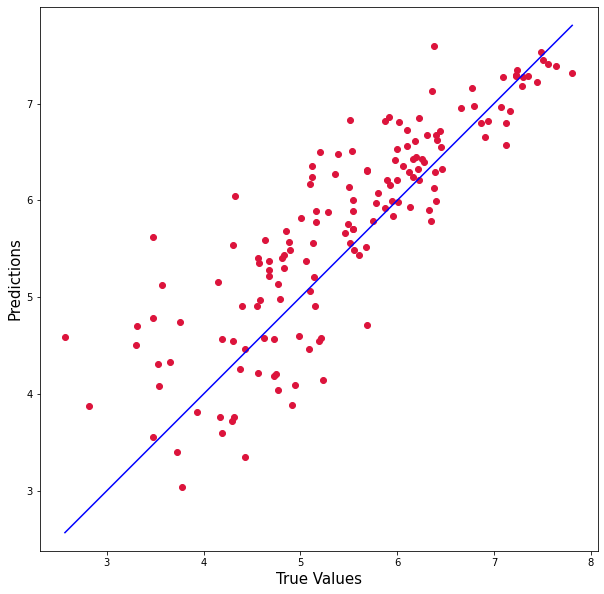

Mean Squared error :  0.42483735993757754
Testing Rscore :0.65434


In [108]:
XNTK = Sequential()
XNTK.add(Dense(units=5, input_dim=4, kernel_initializer='normal', activation='relu'))
XNTK.add(Dense(units=5, kernel_initializer='normal', activation='relu'))
XNTK.add(Dense(units=5, kernel_initializer='normal', activation='relu'))
XNTK.add(Dense(1, kernel_initializer='normal'))

XNTK.compile(loss='mean_squared_error', optimizer='adam')

X_train, X_test, y_train, y_test = train_test_split(dataset_aux2, y, test_size=0.25, random_state=1012)

XNTK.fit(X_train, y_train ,batch_size = 20, epochs = 50, verbose=1)
print("Training Rscore : {:.5f}".format(r2_score(y_train, XNTK.predict(X_train))))

y_pred = XNTK.predict(X_test)
print("Testing Rscore :{:.5f}".format(r2_score(y_test, y_pred)))

Y = dt_2020.values[:,0]
X = dt_2020.values[:,1:] 
y_pred = XNTK.predict(X)

plt.figure(figsize=(10,10))
plt.scatter(Y, y_pred, c='crimson')

p1 = max(max(y_pred), max(Y))
p2 = min(min(y_pred), min(Y))
plt.plot([p1, p2], [p1, p2], 'b-')
plt.xlabel('True Values', fontsize=15)
plt.ylabel('Predictions', fontsize=15)
plt.axis('equal')
plt.show()

print("Mean Squared error : ", mean_squared_error(Y, y_pred))
print("Testing Rscore :{:.5f}".format(r2_score(Y, y_pred))) # Provem el model amb nous exemples (deploy)

Afegint els resultats d'aquest apartat a la taula de progrés dels models obtenim:

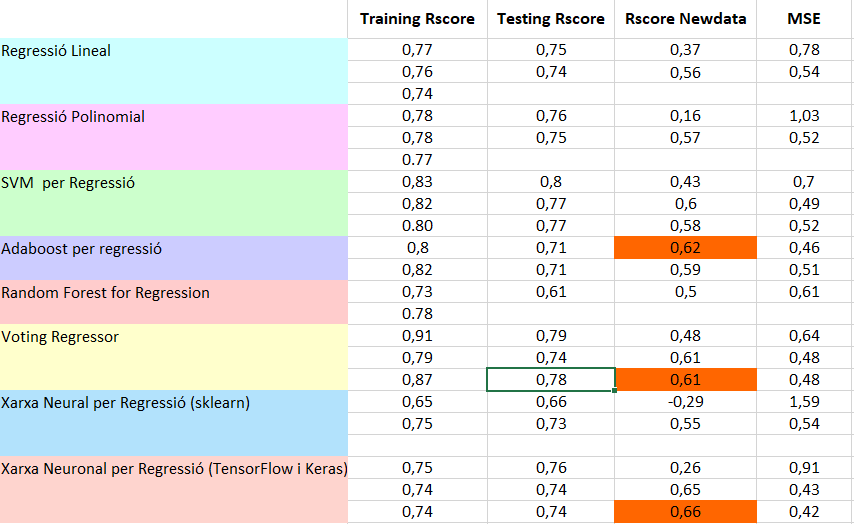

On els models que millor fan la predicció del dataset de 2020 amb el menor MSE són AdaBoost per a Regressió, Vooting Regressor i la Xarxa neuronal feta amb TensorFlow i Keras. A més a més, els plots també indiquen que els models fan una bona predicció.

Tot i així no aconseguia un R2_score del 80% en cap model, tant en el train com el test cap arribava a tenir una R2_score suficientment elevada. Vaig pensar que potser era un problema d'Underfitting (l'Underfitting és un escenari en ciència de dades on un model de dades és incapaç de capturar la relació entre les variables d'entrada i sortida amb precisió, generant una alta taxa d'error tant en el conjunt d'entrenament com en les dades no vistes.), així que vaig tornar a afegir la variable Trust al dataset ja que tenia un 40% de correlació amb la variable objectiu i aquesta va ser la taula resultant:

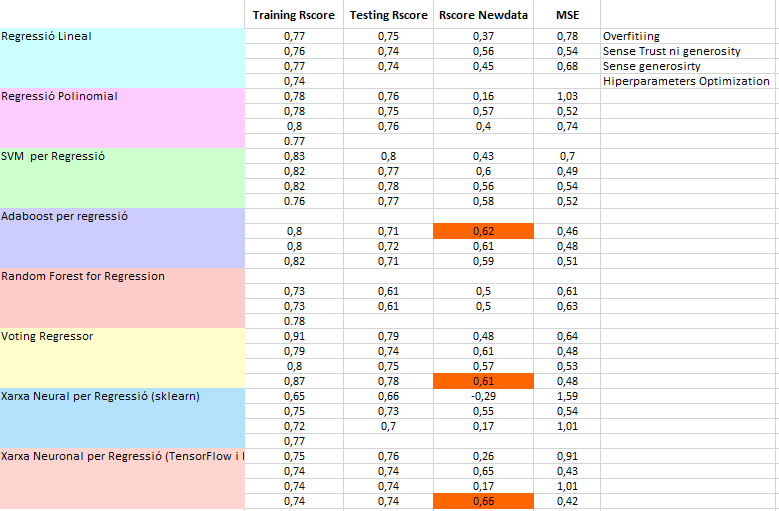

Nota 1: Els models que els hi falta la primera fila van ser introduits a aquesta pràctica després de canviar el dataset.

Nota 2: Els models que els hi falta completar l'última fila van ser descartats per a reduir la cerca d'hiperparametres.

El R2_score empitjoraba molt en aquest cas, així que vaig decidir deixar el dataset amb les 4 features anteriors.

Els models que millor prediuen casos reals son l'AdaBoost amb els hiperparàmetres sense optimitzar (la grid search no ha sigut bona), el Vooting Regressor i la Xarxa Neuronal amb TensorFlow i Keras. Peró, els models que han aprés millor les dades dels conjunts train i test són, en ordre descendent: Vooting Regressor, AdaBoost i la Xarxa Neuronal. 


# Interpretability & Explainability 

Ja que no he pogut trobar una manera d'optimitzar el R2_score fins a un 80%, al menys, en el conjunt de test; dedicaré aquest apartat a entendré que está passant en els 3 models sel·leccionats anteriorment i a trobar un perqué a aquest R2_score tan baix.

Primerament, m'agradaria recordar els r2_score que han donat cadascun dels models escollits en els conjunts train, test i en les dades noves:
- AdaBoost : 80%  - 71% - 62%
- Vooting Regressor : 87% - 78% - 61%
- Xarxa Neuronal : 74% - 74% - 66%

El model més prometedor en conjunt és el el Vooting Regressor. Però tots els models presenten una disminució en les dades de l'any 2020 aixó segurament és degut a la pandèmia, és a dir, com que tot el món es va veure afectat per la pandèmia la felicitat de la població mundial va baixar i no hi ha cap altre variable en el dataset que pugui marcar aquesta relació com per a qué el model pugui aprendre aixó. Afegir una variable boolena Is_pandemia que marqués aquesta relació no tendria sentit, ja que estem entrenant el model per a any que no són 2020.

Seguidament, ens fixarem en quines variables els models en general es fixen més. El model que permet veure aixó de manera més sencilla i directa és el de la Regressió Lineal, els coeficients del qual són:

[2.64740374 0.84189079 1.14304065 1.30400323] que corresponen a les variables Economy(GDP per Capita), Family, Health(Life Expectancy) i Freedom respectivament. 

A partir d'aquí podem afirmar que els models donen més importancia a la GDP, seguida per la llibertat i l'esperança de vida. Si recordem l'apartat de data mining i ordenem (de forma descendent) les variables segons la seva correlació amb el Happiness Score ens queda: Economy(GDP per Capita), Health(Life Expectancy), Family i Freedom. De moment sembla raonable l'el·lecció del coeficients que fan els models, a més correlació amb la variable objectiu més pes tindrà. L'única excepció és el coeficient de la variable Freedom, de les 4 variables és la que menys correlació té amb la variable objectiu ¿ per què se li dona més pes que a les altres dues ?

Pot ser els seus plots ens ayuden a entendre millor la relació entre les variables:

<function matplotlib.pyplot.show(*args, **kw)>

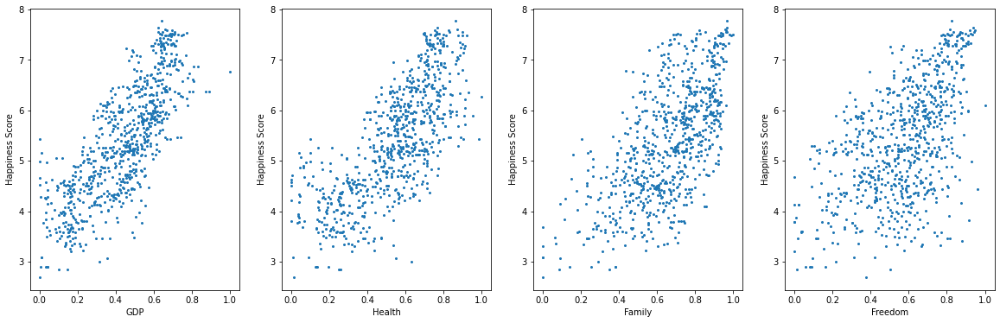

In [109]:
#Scatter amb GDP - Happiness Score 
plt.subplot(1, 4, 1)
plt.scatter(data.values[:,1], data.values[:,0], s=4)
plt.xlabel("GDP")
plt.ylabel("Happiness Score")

#Scatter amb Health - Happiness Score 
plt.subplot(1, 4, 2)
plt.scatter(data.values[:,3], data.values[:,0], s=4)
plt.xlabel("Health")
plt.ylabel("Happiness Score")

#Scatter amb Family - Happiness Score 
plt.subplot(1, 4, 3)
plt.scatter(data.values[:,2], data.values[:,0], s=4)
plt.xlabel("Family")
plt.ylabel("Happiness Score")

#Scatter amb Freedom - Happiness Score
plt.subplot(1, 4, 4)
plt.scatter(data.values[:,4], data.values[:,0], s=4)
plt.xlabel("Freedom")
plt.ylabel("Happiness Score")
fig = plt.gcf()
fig.set_size_inches(20, 6)
plt.show

Observant el primer gràfic es pot entendre perfectament perquè la GDP té una correlació del 79% amb la variable objectiu. Però si ho comparem amb l'últim gràfic, continua sense tenir explicació perquè a la variable Freedom se li ha donat més pes que a les altres.

N'hem a entendre bé que estan fent els models seleccionats pas a pas per a veure si la falta de R2_score s'origina en el pes de la variable Freedom o és només el Regressor Lineal l'únic que dona tant de pes a aquesta variable. Per fer-ho analitzarem l'explicabilitat i la interpretabilitat dels 3 models escollits.

# LIME

Alguns models es poden interpretar fàcilment, com el model de regressió lineal o logística i els arbres de decisió, però interpretar models més complexos com els Random Forests i la xarxa neuronal pot ser un repte. Això de vegades condueix al científic de dades a escollir un model més interpretable, ja que necessiten comunicar-lo al seu gerent o rang superior, que potser no estan familiaritzats amb l'aprenentatge automàtic. El desavantatge és, en general, que el model interpretable té un menor rendiment en termes de precisió o precisió, fent-los menys útils i potencialment perillosos per a la producció. Per tant, existeix una necessitat creixent de com interpretar fàcilment un complex BlackBox model (és a dir, Machine Learning Models que et donen un resultat o prenen una decisió sense explicar ni mostrar com ho van fer).

El mètode LIME és una nova tècnica d'explicació que conta les prediccions de qualsevol classificador o problema de regressió d'una manera interpretable i fidel. Ho fa aprenent un model interpretable localment al voltant de la predicció. Entenent com funciona el nostre model, podem tenir més avantatge en què hauríem de fer i en quin model escollir.

El codi ha estat inspirat per la pàgina : https://www.kaggle.com/code/prashant111/explain-your-model-predictions-with-lime

Les explicacions s'han pogut fer gràcies a : https://algotech.netlify.app/blog/interpreting-black-box-regression-model-with-lime/

Aquest model no sembla donar prioritat a cap variable en particular, en cada predicció els pesos de cada variable no segueixen cap tendència ni preferència.

In [111]:
import lime
import lime.lime_tabular

explainer = lime.lime_tabular.LimeTabularExplainer(X_train.values, feature_names=X_train.columns.values.tolist(),
                                                  class_names=['Happiness Score'], verbose=True, mode='regression')
i = len(X_test)//4
print(i)
exp = explainer.explain_instance(X_test.values[i], AdaBoost.predict, num_features=4) 
exp.show_in_notebook(show_table=True)
exp.as_list()

i = 2*len(X_test)//4
print(i)
exp = explainer.explain_instance(X_test.values[i], AdaBoost.predict, num_features=4) 
exp.show_in_notebook(show_table=True)
exp.as_list()

i = 3*len(X_test)//4
print(i)
exp = explainer.explain_instance(X_test.values[i], AdaBoost.predict, num_features=4) 
exp.show_in_notebook(show_table=True)
exp.as_list()

i = len(X_test)-35 # Per veure alguna mostra amb GDP més elevada
print(i)
exp = explainer.explain_instance(X_test.values[i], AdaBoost.predict, num_features=4) 
exp.show_in_notebook(show_table=True)
exp.as_list()

49
Intercept 5.625233572088566
Prediction_local [4.324892]
Right: 4.160681817531586


98
Intercept 5.675751915454984
Prediction_local [4.18065083]
Right: 4.604833333333333


147
Intercept 5.771857518921859
Prediction_local [3.83570908]
Right: 4.113280707392778


161
Intercept 5.379865744929404
Prediction_local [5.10941793]
Right: 5.228666678342965


[('0.47 < Economy (GDP per Capita) <= 0.59', 0.40866701725075566),
 ('Freedom <= 0.43', -0.3464621768065021),
 ('Family <= 0.52', -0.2092767260970199),
 ('0.38 < Health (Life Expectancy) <= 0.57', -0.12337592517583215)]

En la primera observació, el que més afecta negativament a la felicitat de les persones d'aquell país en aquell any era el pobre estat econòmic del país, seguit de l'esperança de vida curta. L'única variable que afecta positivament i que fa que el valor de la predicció augmenti és la llibertat per a poder fer el que volguessin amb la seva vida.

La segona mostra no té cap indicador que faci augmentar la felicitat de la població d'aquella regió, però no disminueixen tant com els valors de la tercera observació que fan que la predicció de l'Happiness Score sigui encara més petita.

En l'última mostra, a diferència de les altres, el país estava en un bon estat econòmic cosa que feia augmentar la felicitat de la seva població. Tanmateix, el fet de tenir una esperança de vida molt baixa afectava negativament a la felicitat de les persones d'aquell país juntament amb la falta de llibertat per poder fer el que volguessin amb la seva vida i la mancança de suport per part d'amics i familiars.

In [112]:
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.values, feature_names=X_train.columns.values.tolist(),
                                                  class_names=['Happiness Score'], verbose=True, mode='regression')
i = len(X_test)//4
print(i)
exp = explainer.explain_instance(X_test.values[i], VotingReg.predict, num_features=4) 
exp.show_in_notebook(show_table=True)
exp.as_list()

i = 2*len(X_test)//4
print(i)
exp = explainer.explain_instance(X_test.values[i], VotingReg.predict, num_features=4) 
exp.show_in_notebook(show_table=True)
exp.as_list()

i = 3*len(X_test)//4
print(i)
exp = explainer.explain_instance(X_test.values[i], VotingReg.predict, num_features=4) 
exp.show_in_notebook(show_table=True)
exp.as_list()

i = len(X_test)-35 # Per veure alguna mostra amb GDP més elevada
print(i)
exp = explainer.explain_instance(X_test.values[i], VotingReg.predict, num_features=4) 
exp.show_in_notebook(show_table=True)
exp.as_list()

49
Intercept 5.572347292113999
Prediction_local [4.32411775]
Right: 4.124309946535354


98
Intercept 5.702375243461451
Prediction_local [3.98094151]
Right: 4.164658633498512


147
Intercept 5.773054028491095
Prediction_local [3.77210573]
Right: 3.9671559842320083


161
Intercept 5.380444629499556
Prediction_local [4.92662336]
Right: 5.006031823843341


[('Freedom <= 0.43', -0.4411265060123538),
 ('Family <= 0.52', -0.3398883973259814),
 ('0.47 < Economy (GDP per Capita) <= 0.59', 0.3243990159550762),
 ('0.38 < Health (Life Expectancy) <= 0.57', 0.00279461880472709)]

Aquest model es diferencia en el fet que fa prediccions més negatives que les realitzades amb AdaBoost. A part d'això totes les variables afecten positiva o negativament de la mateixa forma que en l'AdaBoost però amb uns coeficients una mica més petits.
Una gran diferència és en com prediu l'última observació, l'Happiness Score és més petit que en l'anterior i totes les variables l'afecten negativament, ni tan sols el GDP com en l'AdaBoost.

Es podria dir que el Voting Regressor tendeix a ser més negatiu en les prediccions de la felicitat de les poblacions que l'AdaBoost. També que li dona més pes a l'economia i a l'esperança de vida per a predir la felicitat de la gent.

In [113]:
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.values, feature_names=X_train.columns.values.tolist(),
                                                  class_names=['Happiness Score'], verbose=True, mode='regression')
i = len(X_test)//4
print(i)
exp = explainer.explain_instance(X_test.values[i], XNTK.predict, num_features=4) 
exp.show_in_notebook(show_table=True)
exp.as_list()

i = 2*len(X_test)//4
print(i)
exp = explainer.explain_instance(X_test.values[i], XNTK.predict, num_features=4) 
exp.show_in_notebook(show_table=True)
exp.as_list()

i = 3*len(X_test)//4
print(i)
exp = explainer.explain_instance(X_test.values[i], XNTK.predict, num_features=4) 
exp.show_in_notebook(show_table=True)
exp.as_list()

i = len(X_test)-35 # Per veure alguna mostra amb GDP més elevada
print(i)
exp = explainer.explain_instance(X_test.values[i], XNTK.predict, num_features=4) 
exp.show_in_notebook(show_table=True)
exp.as_list()

49
157/157 [==============================] - 0s 876us/step
Intercept 5.566291765044989
Prediction_local [4.7544358]
Right: 4.416101


98
157/157 [==============================] - 0s 959us/step
Intercept 5.801761604143568
Prediction_local [4.07198403]
Right: 4.0225325


147
157/157 [==============================] - 0s 1ms/step
Intercept 5.813370346279712
Prediction_local [4.03617492]
Right: 3.981405


161
157/157 [==============================] - 0s 914us/step
Intercept 5.611300675264629
Prediction_local [4.70413527]
Right: 4.848485


[('Freedom <= 0.43', -0.5415520497397182),
 ('Family <= 0.52', -0.4522656391337504),
 ('0.47 < Economy (GDP per Capita) <= 0.59', 0.19046214965263047),
 ('0.38 < Health (Life Expectancy) <= 0.57', -0.10380987080613426)]

En aquesta xarxa neuronal les explicacions per a cada observació són les mateixes que en el Voting Regressor. En l'última mostra l'economia del país afecta negativament en la felicitat de les persones. En general, la xarxa neuronal no li dona molt de pes a la variable Family i ho reparteix molt similarment entre les altres variables.

En conclusió, l'AdaBoost és el model més optimista a l'hora de fer les prediccions, seguit de la xarxa neuronal. El Voting Regressor tendeix a donar-li més pes a l'economia i a l'esperança de vida, i és el model que fa les prediccions més negatives. La xarxa neuronal sembla desfavorir al suport d'amics i familiars en la predicció de la felicitat de la gent i dona un pes equivalent a les altres variables. Finalment, l'AdaBoost no tendeix a donar més pes a cap variable.

Donat que l'any 2020 va ser un any molt pessimista per culpa de la pandèmia sembla natural que el Voting Regressor i la Xarxa neuronal prediguin millor l'Happiness Score que el model optimista (AdaBoost).

### Ploting residual plots

Però com de bé fan les prediccions els models per anys no pessimistes ? La millor manera d'observar-ho és fent els plots dels residuals en el conjunt test y els valors predits en el mateix conjunt. Els residuals són la diferència entre els valors predits y els valors reals.

7/7 [==============================] - 0s 1ms/step


<function matplotlib.pyplot.show(*args, **kw)>

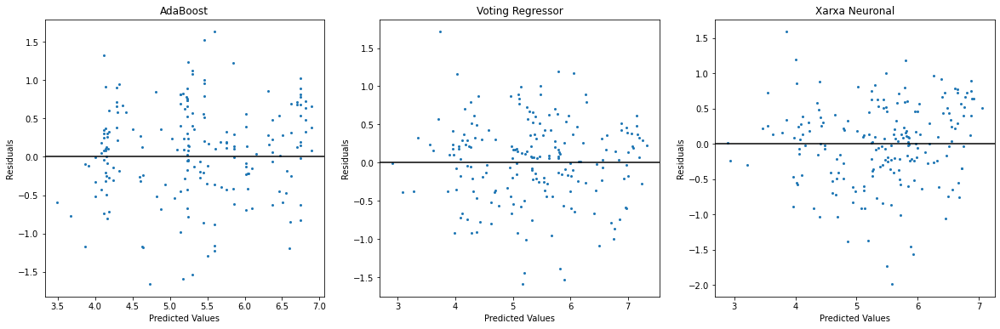

In [114]:
plt.subplot(1, 3, 1)
y_pred = AdaBoost.predict(X_test)
res = y_test - y_pred
plt.scatter(y_pred, res, s=4)
plt.title('AdaBoost')
plt.axhline(y = 0, color = 'black', linestyle = '-')
plt.xlabel("Predicted Values")
plt.ylabel("Residuals")

 
plt.subplot(1, 3, 2)
y_pred = VotingReg.predict(X_test)
res = y_test - y_pred
plt.scatter(y_pred, res, s=4)
plt.title('Voting Regressor')
plt.axhline(y = 0, color = 'black', linestyle = '-')
plt.xlabel("Predicted Values")
plt.ylabel("Residuals")

plt.subplot(1, 3, 3)
y_pred = np.reshape(XNTK.predict(X_test), 196)
res = y_test - y_pred
plt.scatter(y_pred, res, s=4)
plt.title('Xarxa Neuronal')
plt.axhline(y = 0, color = 'black', linestyle = '-')
plt.xlabel("Predicted Values")
plt.ylabel("Residuals")
fig = plt.gcf()
fig.set_size_inches(20, 6)
plt.show

Per a poder afirmar que un model funciona correctament, cal que els plots dels seus residuals tingui una distribució normal. En altres paraules, que la majoria de punts estiguin pròxims al zero (linia negra) i que pocs punt estiguin allunyats. Com més propers a zeros siguin els residuals, menys error farà el model en les prediccions.

En el primer cas, observem una distribució bastant aleatòria i uniforme dels residus contra l'objectiu en dues dimensions. Això sembla indicar que el nostre model lineal està funcionant bé.

En el cas del Voting Regressor, observem més punts al voltant de la linia negra i molts menys punts allunyats que en l'AdaBoost. 

En l'últim cas, els residuals semblen més dispersos que en el cas anterior pero no tant com en l'AdaBoost.

En conjunt, tots 3 models funcionen correctament, però el que té menys error en les seves prediccions és el Voting Regresor, seguit per la xarxa neuronal i deixant últim a l'AdaBoost. No hi ha cap problema en com estan predint els models escollits, la falta de R2_score esmentada anteriorment és deguda a l'any pessimista escollit per a testejar encara més les dades. Si ens centrem només en l'R2_score dels conjunts train i test, encara baixos, és degut al fet que els models no tenen dades suficients per a aprendre a modelar bé una cosa tan subjectiva com la felicitat. Per a obtenir un R2_score s'haurien d'obtenir moltes més files i variables noves que tinguin una correlació alta amb l'Happiness Score.

Resumint, els models AdaBoost, Voting Regressor i la Xarxa Neuronal feta amb TensorFlow i Keras són els que millor prediuen la felicitat de les persones encara que sigui un tema molt subjectiu. La falta de precisió és deu a què només hi havien 782 mostres en total de les dades recollides en cinc anys amb les que treballar i no suficients variables útils en cada any.

# Conclusions 

El World Happiness Report és un informe útil elaborat per les Nacions Unides que permet a les nacions veure com el nivell de felicitat dels ciutadans es relaciona amb els nivells de felicitat d'altres països. Preguntes com "quines característiques específiques d'una nació determinen el nivell de felicitat dels ciutadans?" i "quina d'aquestes característiques hauria de millorar una nació per assegurar que els ciutadans siguin feliços?" es poden respondre a través del procés de l'anàlisi de les dades realitzat.

Per a respondre a les preguntes anteriors, sabem que el PIB és l'indicador més fort de felicitat. Un país decebut en la seva puntuació hauria d'intentar augmentar el seu PIB per càpita primer. Obtenir millors puntuacions en l'esperança de salut, el suport social i la llibertat no faria mal, i la Generositat i les Percepcions de la Corrupció poden ser colpejades o perdudes (totes aquestes mètriques ajudarien a fer que un país se centrés a maximitzar la inversió de recursos per millorar la seva puntuació de felicitat).

Per a poder predir com serà de feliç la població d'un país fent modificacions en el PIB per càpita, l'esperança de salut, el suport social o la llibertat, els millors models a fer són: l'AdaBoost, el Voting Regressor i la Xarxa Neuronal. Per a prediccions una mica pessimistes és recomanable utilitzar el Voting Regressor, mentre que per a prediccions més optimistes ho és l'AdaBoost.